# ATAC annotation using Scanpy

In [1]:
import scanpy as sc
import anndata as ad
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import scipy as sp

from matplotlib import colors

import os
import anndata

In [2]:
sc.logging.print_header()

scanpy==1.7.2 anndata==0.7.6 umap==0.5.1 numpy==1.20.3 scipy==1.7.1 pandas==1.2.5 scikit-learn==0.24.2 statsmodels==0.12.2 python-igraph==0.9.6 louvain==0.7.0


In [3]:
sc.set_figure_params(scanpy=True, dpi=80, dpi_save=250,
                     frameon=False,
                     color_map="YlGnBu", format='pdf', transparent=False,
                    ipython_format='png2x', figsize=(8,8))

In [4]:
#Define a nice colour map for gene expression
colors2 = plt.cm.Reds(np.linspace(0, 1, 128))
colors3 = plt.cm.Greys_r(np.linspace(0.7,0.8,3))
colorsComb = np.vstack([colors3, colors2])
mymap = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)

In [5]:
os.getcwd()

'/home/jovyan/project/neurips2021-notebooks/notebooks/analysis/s2d4'

In [6]:
os.chdir('../../../data/')

## Load data

In [7]:
# Load data preprocessed with Signac
adata_atac = sc.read_h5ad('adata_geneAct.h5ad')

In [8]:
adata_atac

AnnData object with n_obs × n_vars = 9527 × 19039
    obs: 'nCount_peaks', 'atac_fragments', 'TSS.enrichment', 'reads_in_peaks_frac', 'blacklist_fraction', 'nucleosome_signal'
    obsm: 'lsi_full', 'lsi_red', 'peaks', 'umap'

### ATAC Marker genes

In [327]:
marker_genes = {
    'CD14+ Mono': ['TREM1', 'FPR1'],
    'CD16+ Mono': ['LYN', 'TCF7L2'],
    'ID2-hi myeloid prog': ['KLF4'],
    'cDC2': ['TREM1', 'DMXL2'], # Note: DMXL2 should be negative
    'Reticulocyte': ['GATA1', 'HBA1', 'SLC4A1', 'SLC25A37', 'KLF1'],
    'Erythroblast': ['GATA1', 'MKI67'],
    'Proerythroblast': ['GATA2', 'SYNGR1'], #, 'CRACD'
    'NK': ['CD160', 'GNLY', 'GRIK4', 'CD247'],
    'ILC': ['SPON2', 'GZMB', 'PRF1'], # , 'C69'# Note CD69 should be negative
    'Lymph prog': ['MME', 'IGLL1', 'VPREB1', 'CD79B'],
    'Naive CD20+ B': ['MS4A1', 'LYN', 'CD74', 'BLK'],
    'B1 B': ['ITGB1', 'MS4A1', 'DUSP22', 'EPHA4'],
    'Transitional B': ['MME', 'CD38', 'CD24'],
    'Plasma cells': ['DUSP22', 'FNDC3B'],
    'CD4+ T activated': ['JAKMIP1', 'C4orf50'],
    'CD4+ T naive': [ 'BCL11B', 'BACH2', 'JAKMIP1', 'C4orf50'], # Note JAKMIP1 and C4orf50 are negative markers
    'CD8+ T': ['CD8A', 'CD8B'],
    'pDCs': ['PTPRS', 'TCF4', 'KCNN3', 'DUSP22'],
    'G/M prog': ['MPO','NT5DC3'],
    'HSC': ['PRDM16','MTRNR2L1'], #,'TAMALIN'
    'MK/E prog': ['DNAJC6']
}

## Clustering

Choose the reduced set of LSI components stored in adata.obsm.lsi_red and cluster on various resolutions.

In [281]:
sc.pp.neighbors(adata_atac, use_rep = 'lsi_red')

In [282]:
sc.tl.leiden(adata_atac, resolution=0.3, key_added='leiden_res0.3')
sc.tl.leiden(adata_atac, resolution=0.5, key_added='leiden_res0.5')
sc.tl.leiden(adata_atac, resolution=0.8, key_added='leiden_res0.8')
sc.tl.leiden(adata_atac, resolution=1, key_added='leiden_res1')

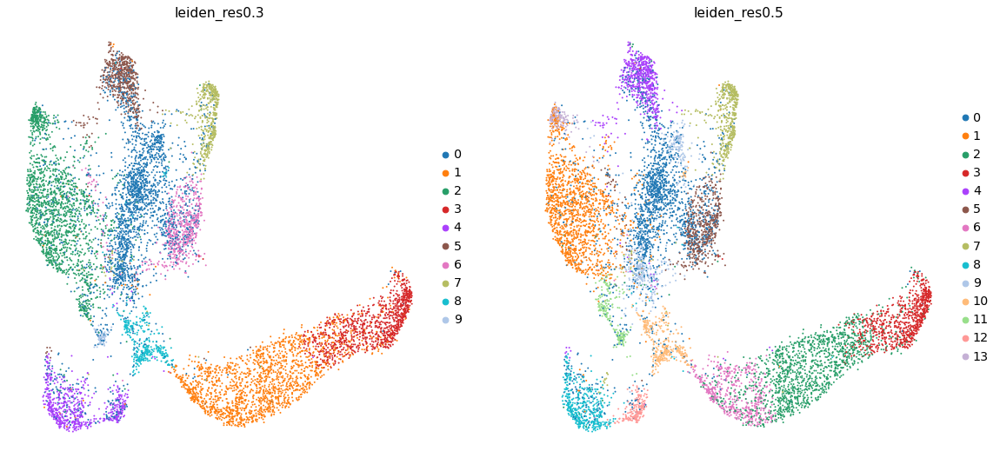

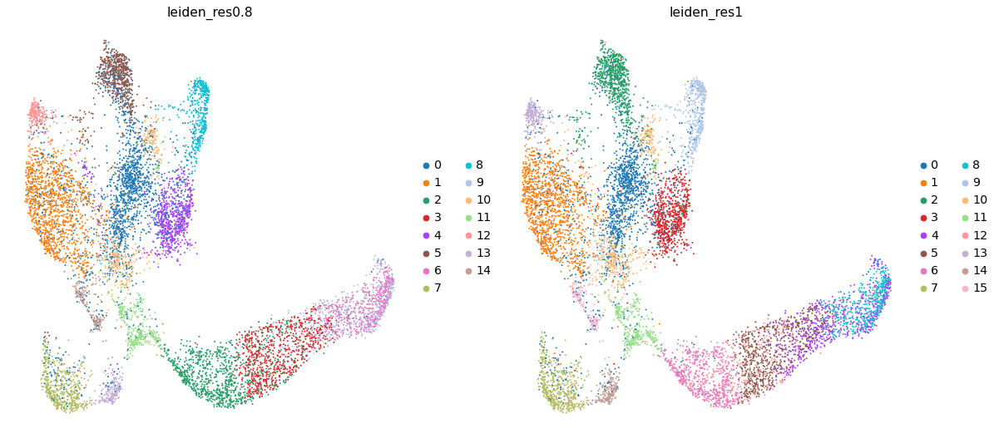

In [283]:
sc.pl.umap(adata_atac, color=['leiden_res0.3', 'leiden_res0.5'])
sc.pl.umap(adata_atac, color=['leiden_res0.8', 'leiden_res1'])

Choose rather coarse resolution that captures the main clusters (here: 0.5)

## QC and marker gene overview

In [284]:
# Select column that should be visualized
leiden_clus_col = 'leiden_res0.5'
# Name for added ranked genes per group
rank_id = 'rank_genes_res0.5'

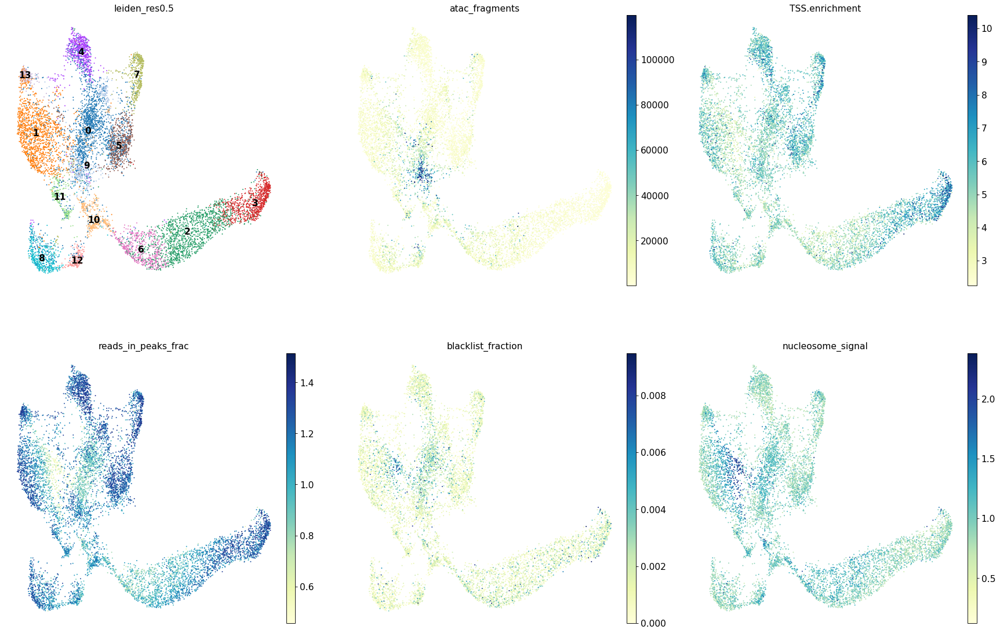

In [285]:
sc.pl.umap(adata_atac, color=[leiden_clus_col, 'atac_fragments', 'TSS.enrichment',
                              'reads_in_peaks_frac','blacklist_fraction','nucleosome_signal'],
          legend_loc = 'on data',
          ncols=3)

In [286]:
sc.tl.rank_genes_groups(adata_atac,
                        groupby= leiden_clus_col,
                        key_added = rank_id)

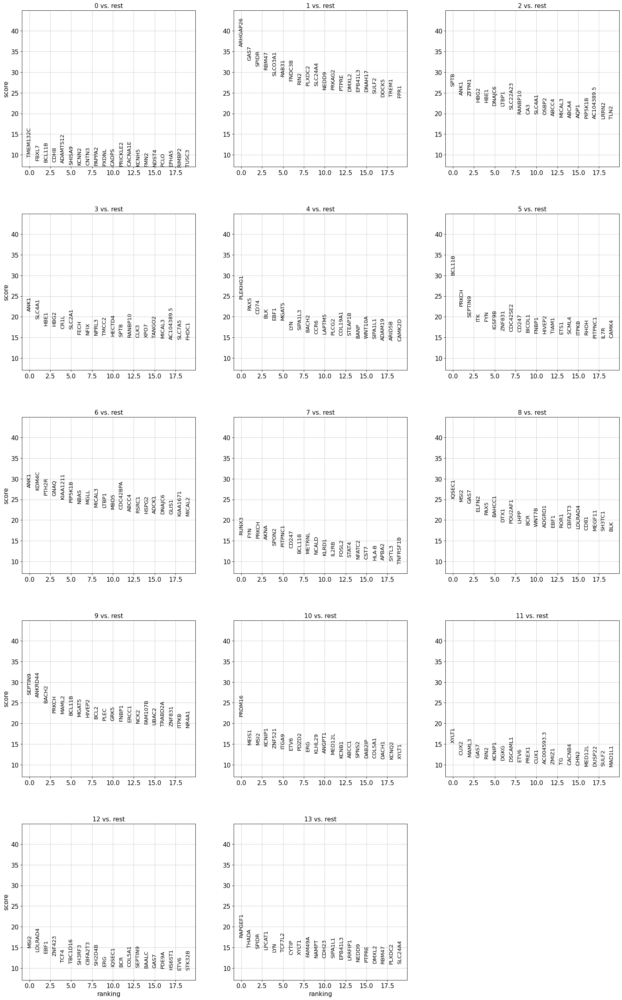

In [287]:
sc.pl.rank_genes_groups(adata_atac, key = rank_id, ncols=3, fontsize=12)

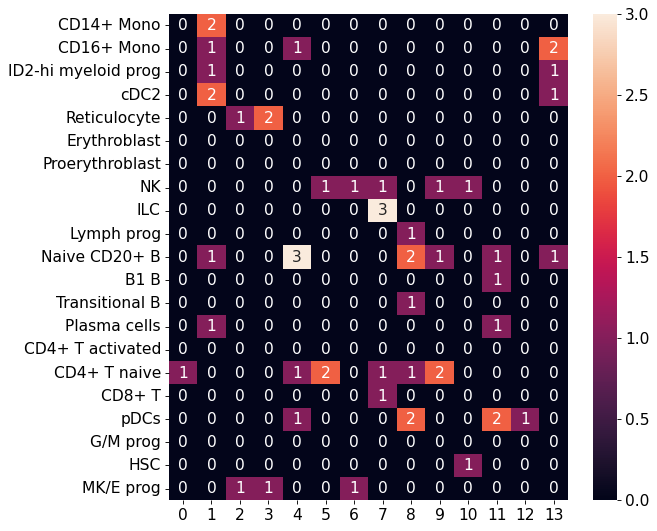

In [288]:
sns.heatmap(sc.tl.marker_gene_overlap(adata_atac,
                                      reference_markers=marker_genes,
                                      key= rank_id), annot=True)

plt.show()

In [289]:
# Initial clustering:

init_clus_dict = {
    
    '0':['CD4+ T naive'],
    '1':['CD 14+ Mono','CD 16+ Mono','CD 16+ Mono prog','cDC2'],
    '2':['MK/E prog','Reticulocyte'], #'CD4+ T naive','CD4+ T activated','CD8+ T'],
    '3':['Reticulocyte'], 
    '4':['Naive CD20+ B'],
    '5':['CD4+ T naive'],
    '6':['NK', 'MK/E prog'],
    '7':['NK', 'ILC'], #,'CD8+ T'],
    '8':['Naive CD20+ B','pDCs'],
    '9':['CD4+ T naive'],
    '10':['HSC'],
    '11':['pDCs'],
    '12':['pDCs'],
    '13':['CD 14+ Mono','CD 16+ Mono','CD 16+ Mono prog','cDC2']
    
}


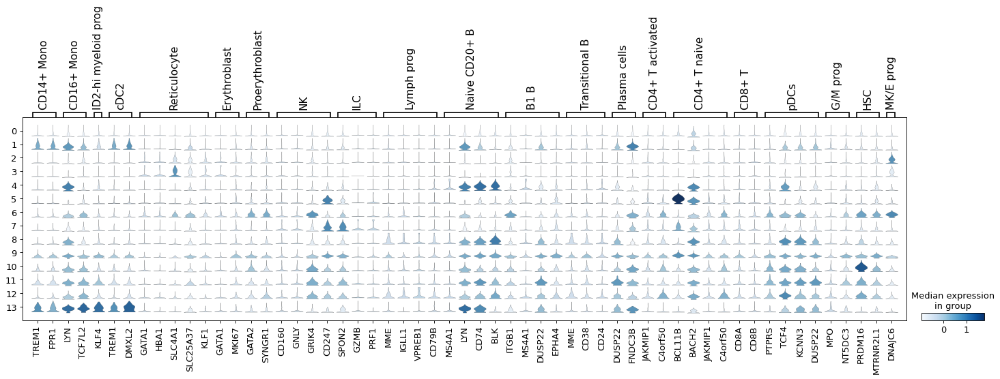

In [290]:
# Reduce to marker genes in gene activity matrix
filt_marker_genes = dict()
for key,val in marker_genes.items():
    filt_vals = [i for i in val if i in adata_atac.var_names]
    filt_marker_genes[key] = filt_vals

# Scale and plot
adata_plot = adata_atac.copy()
sc.pp.scale(adata_plot, max_value=5)
    
sc.pl.stacked_violin(adata_plot, var_names = filt_marker_genes,
                     groupby= leiden_clus_col,
                     use_raw=False)

In [291]:
marker_genes.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'ID2-hi myeloid prog', 'cDC2', 'Reticulocyte', 'Erythroblast', 'Proerythroblast', 'NK', 'ILC', 'Lymph prog', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'CD4+ T activated', 'CD4+ T naive', 'CD8+ T', 'pDCs', 'G/M prog', 'HSC', 'MK/E prog'])

### Plot marker genes

Check whether marker gene expression gives hint to subclusters of initial clusters.

Some marker genes are negative: DMXL2 for cDC2; CD69 for ILCs; JAKMIP1 and C4orf50 for naive T cells.

Due to the sparsity of the ATAC data, increased gene activity is not always very obivios. Try to keep keep clear markers for other celltypes in mind.

Cluster: CD14+ Mono


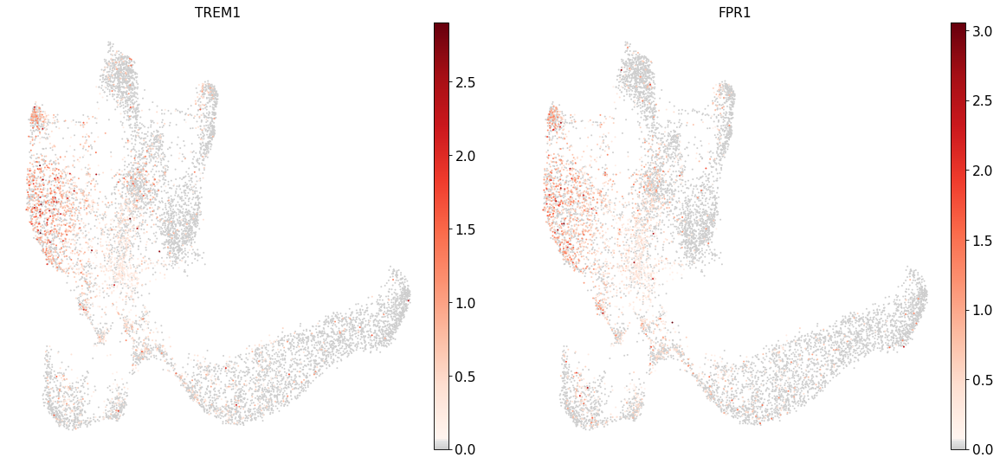

Cluster: CD16+ Mono


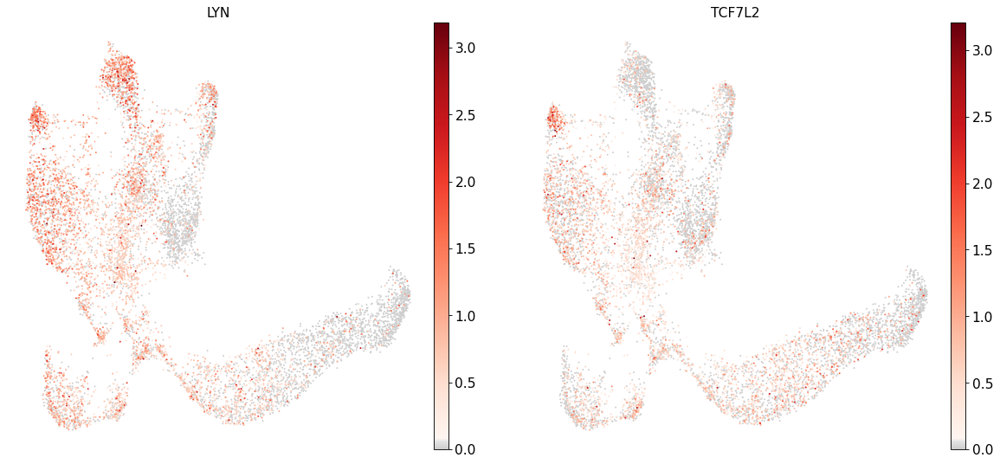

Cluster: ID2-hi myeloid prog


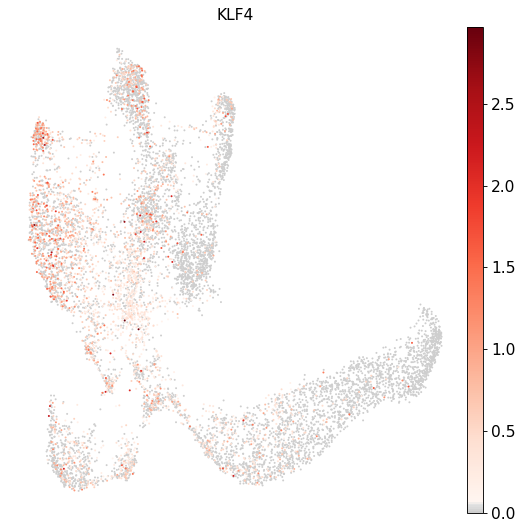

Cluster: cDC2


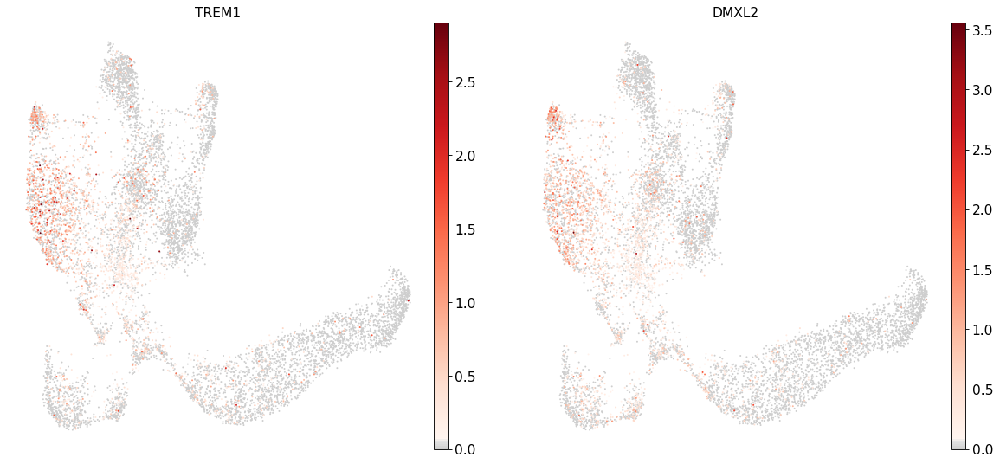

Cluster: Reticulocyte


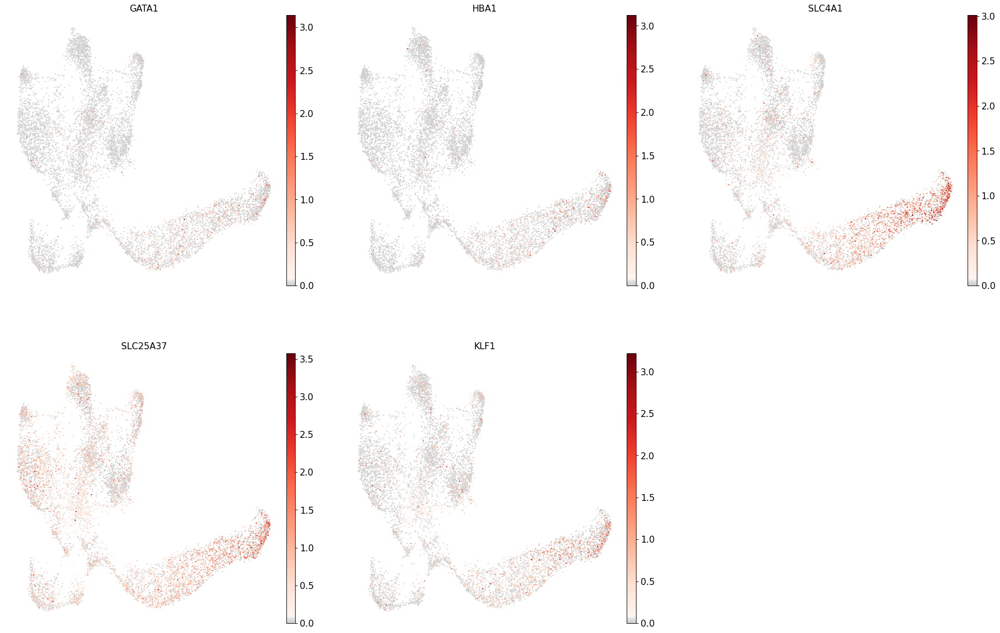

Cluster: Erythroblast


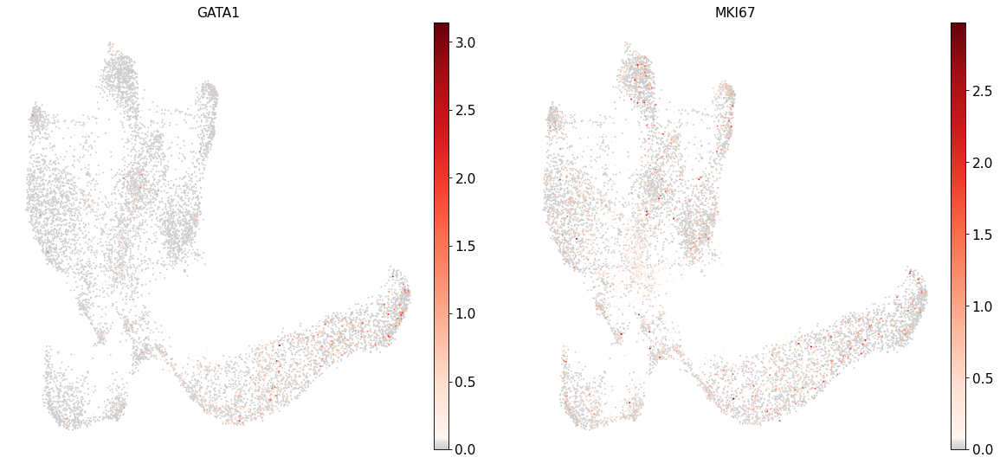

Cluster: Proerythroblast


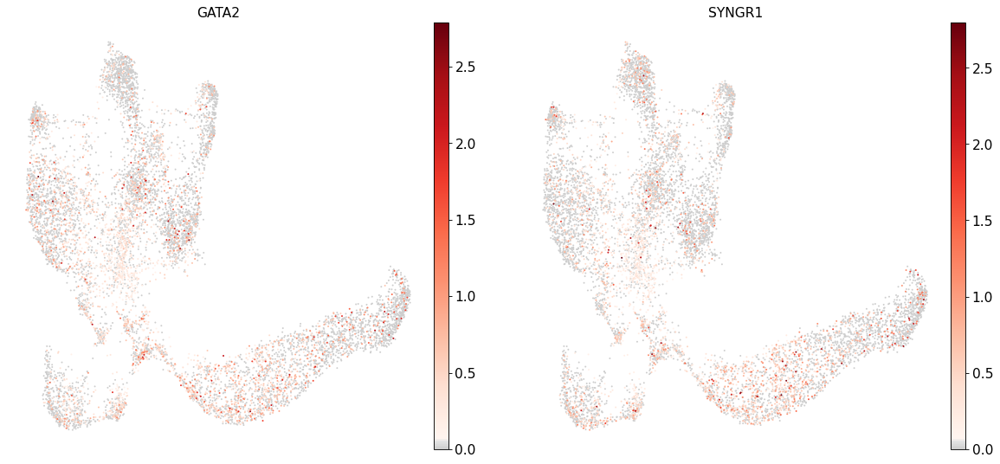

Cluster: NK


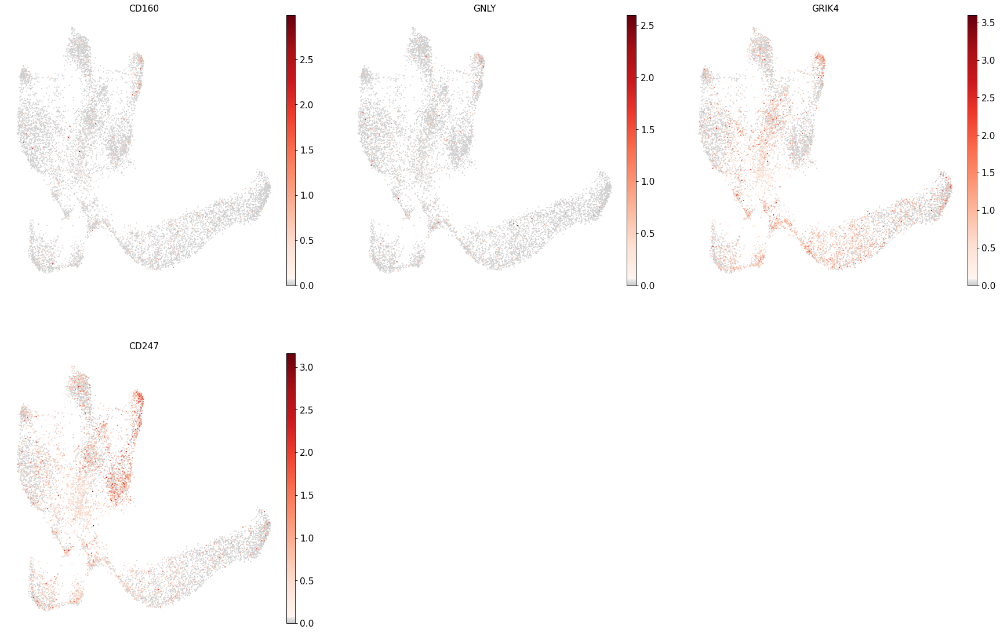

Cluster: ILC


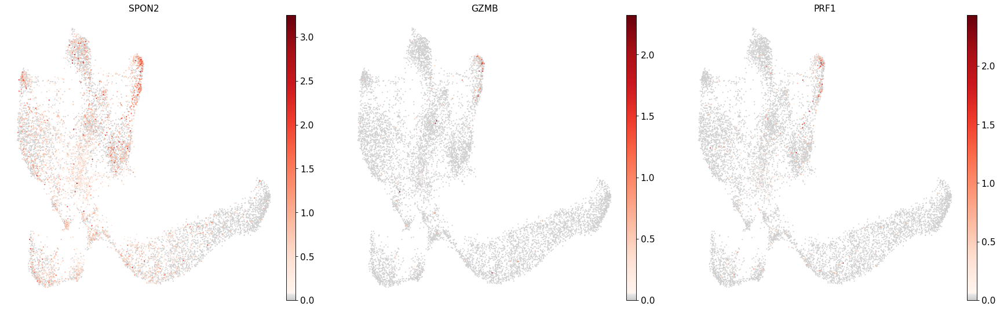

Cluster: Lymph prog


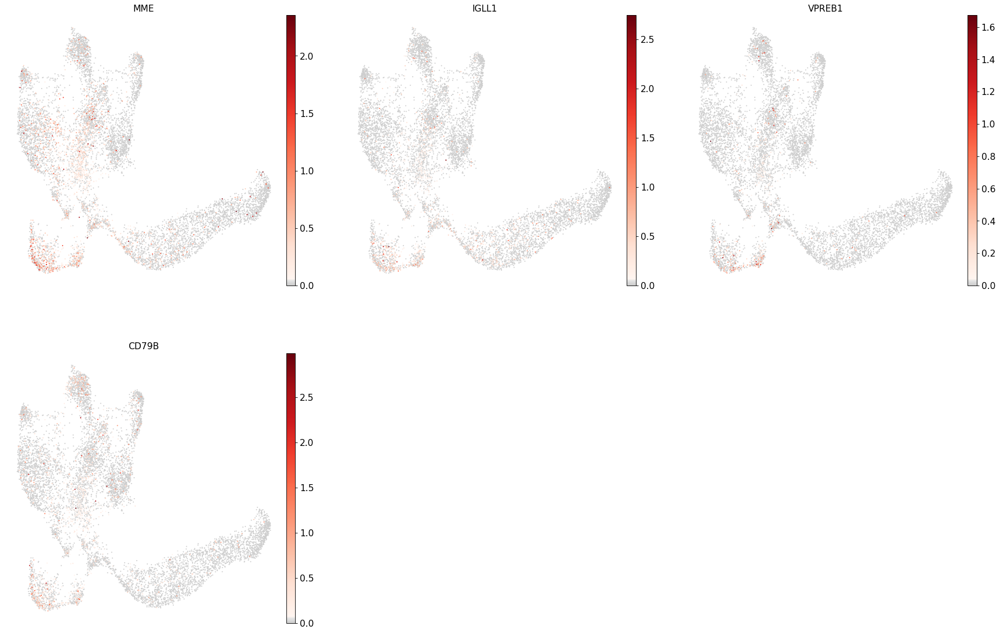

Cluster: Naive CD20+ B


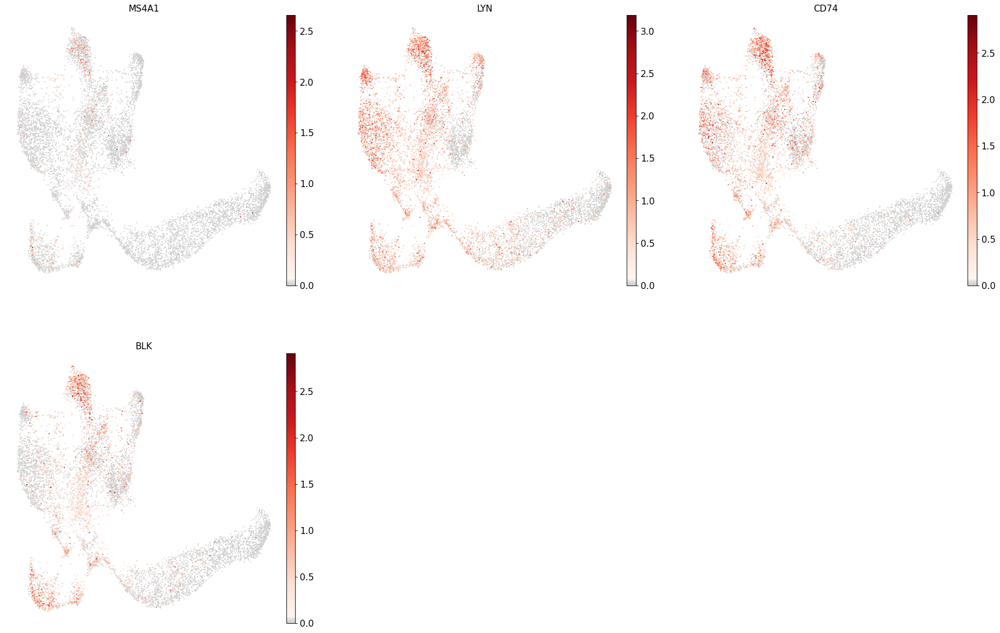

Cluster: B1 B


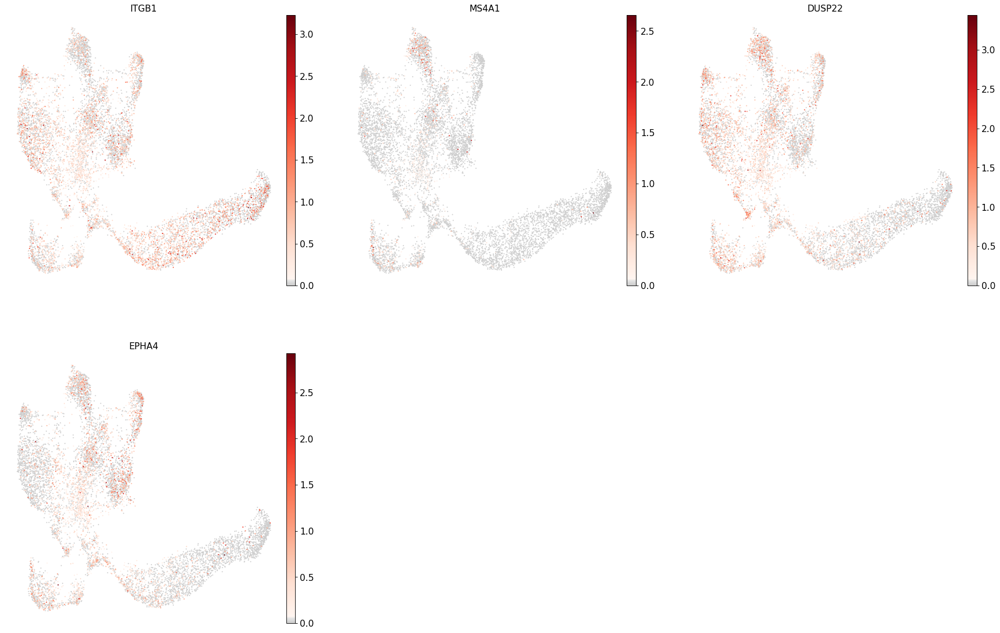

Cluster: Transitional B


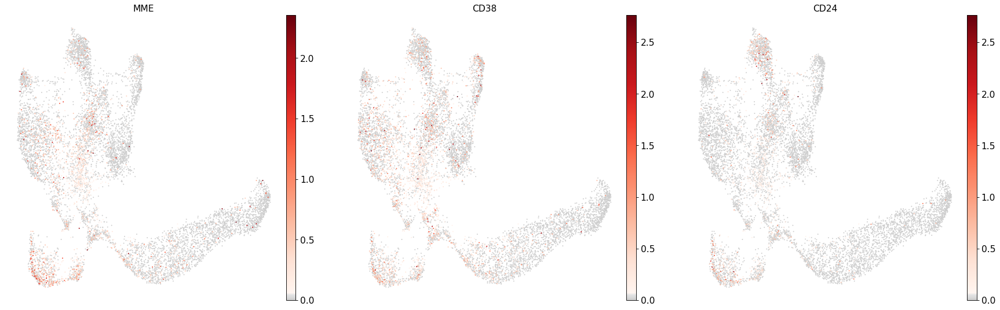

Cluster: Plasma cells


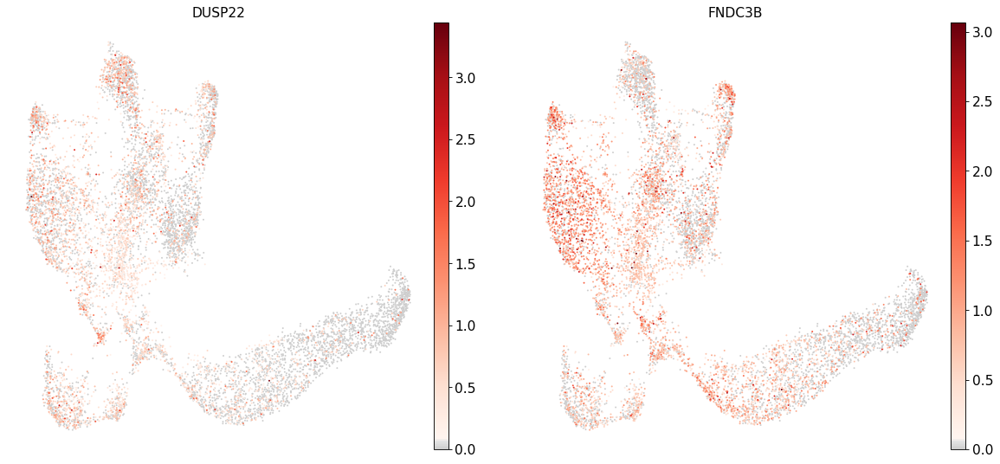

Cluster: CD4+ T activated


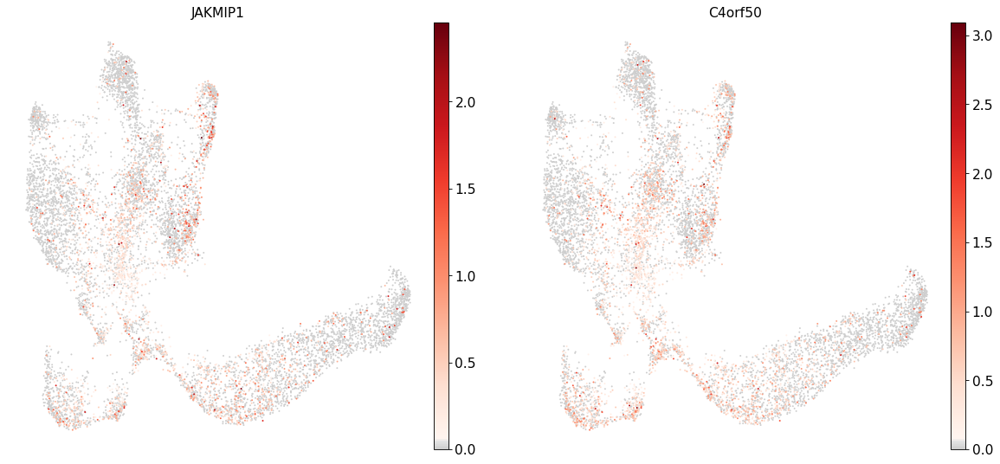

Cluster: CD4+ T naive


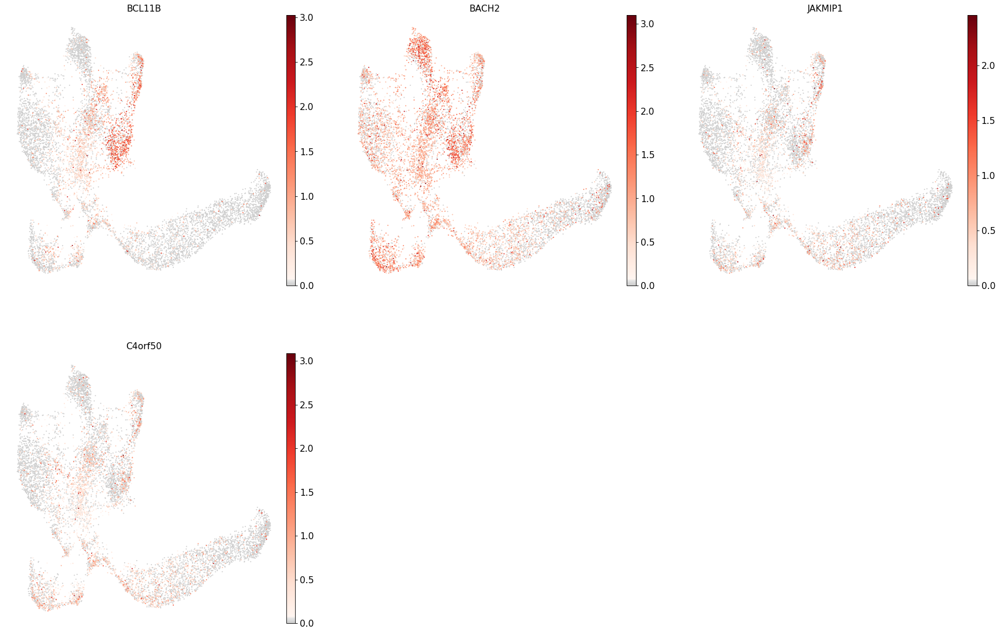

Cluster: CD8+ T


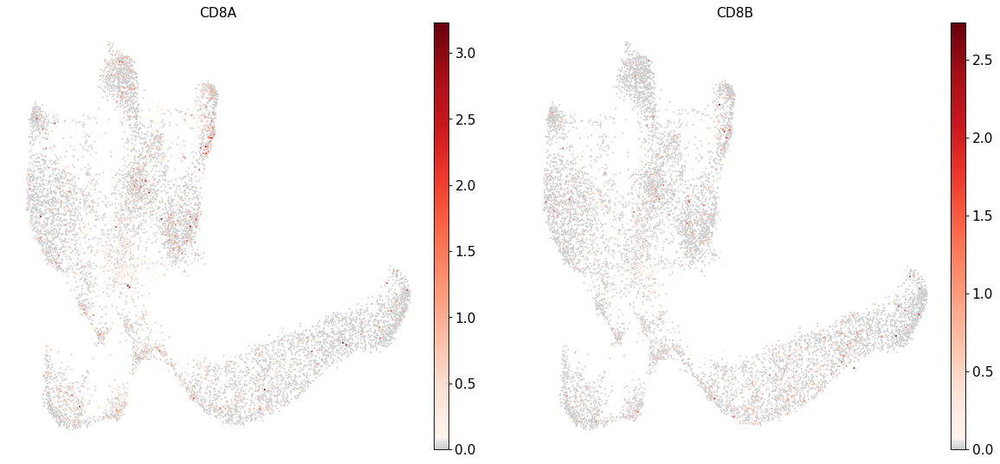

Cluster: pDCs


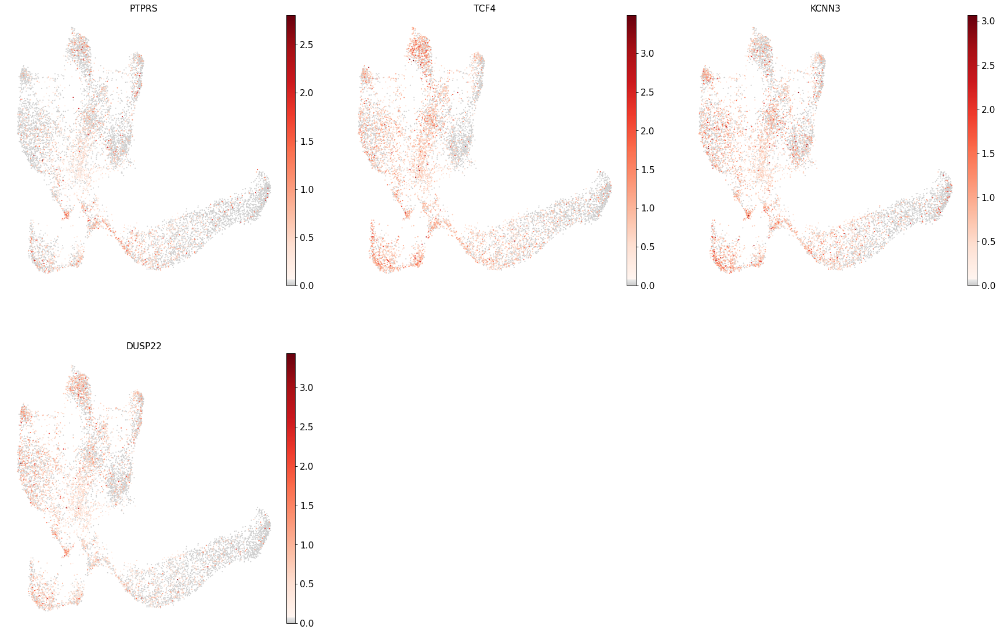

Cluster: G/M prog


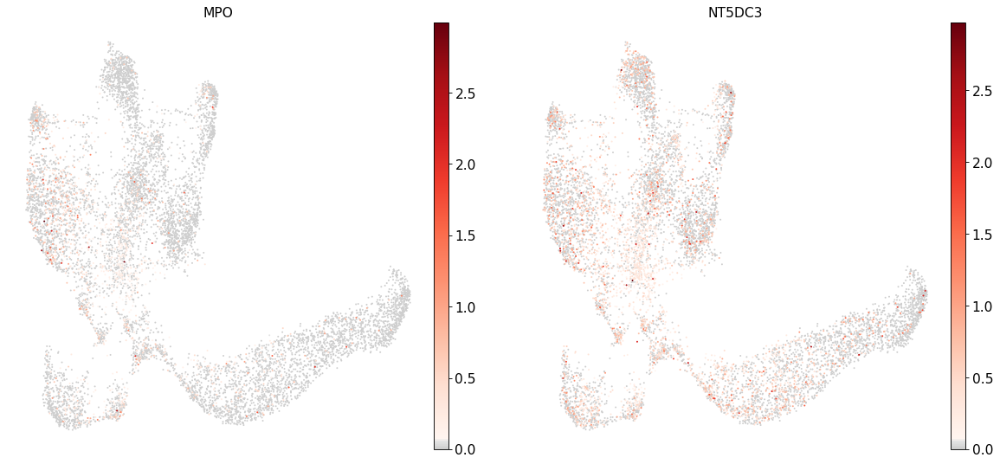

Cluster: HSC


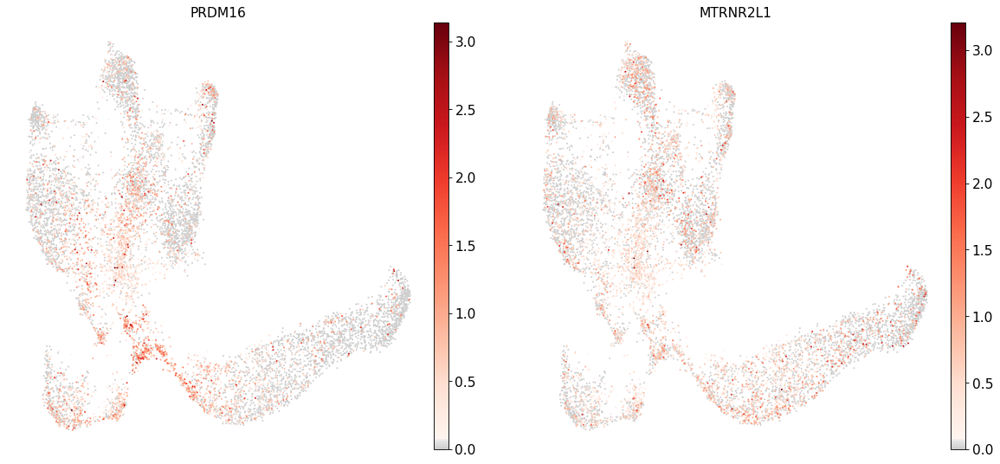

Cluster: MK/E prog


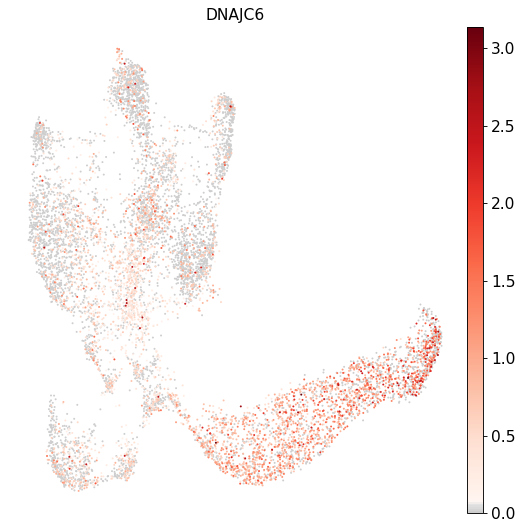

In [292]:
for i in marker_genes.keys():
    print(f'Cluster: {i}')
    genes_to_plot = [i for i in marker_genes[i] if i in adata_atac.var_names]
    sc.pl.umap(adata_atac, color=genes_to_plot, ncols=3, use_raw=False, cmap=mymap)

# Subclustering

Subclustering can be done by considering the marker genes and clustering of clear substructure in the data. Here we go through the clusters based on the major cell types identified above.


In [293]:
# Initial clustering:

init_clus_dict = {   
    '0':['CD4+ T naive'],
    '1':['CD 14+ Mono','CD 16+ Mono','CD 16+ Mono prog','cDC2'],
    '2':['Erythroblast'], #'CD4+ T naive','CD4+ T activated','CD8+ T'],
    '3':['Normoblast'], 
    '4':['Naive CD20+ B'],
    '5':['CD4+ T naive','CD4+ T activated'],
    '6':['Proerythroblast'],
    '7':['NK', 'ILC', 'CD8+ T'], #,'CD8+ T'],
    '8':['Naive CD20+ B','pDCs'],
    '9':['CD4+ T naive'],
    '10':['HSC'],
    '11':['pDCs'],
    '12':['pDCs'],
    '13':['CD 14+ Mono','CD 16+ Mono','CD 16+ Mono prog','cDC2']
    
}


## Monocytes and DCs

In [294]:
marker_genes

{'CD14+ Mono': ['TREM1', 'FPR1'],
 'CD16+ Mono': ['LYN', 'TCF7L2'],
 'ID2-hi myeloid prog': ['KLF4'],
 'cDC2': ['TREM1', 'DMXL2'],
 'Reticulocyte': ['GATA1', 'HBA1', 'SLC4A1', 'SLC25A37', 'KLF1'],
 'Erythroblast': ['GATA1', 'MKI67'],
 'Proerythroblast': ['GATA2', 'CRACD', 'SYNGR1'],
 'NK': ['CD160', 'GNLY', 'GRIK4', 'CD247'],
 'ILC': ['SPON2', 'GZMB', 'PRF1', 'C69'],
 'Lymph prog': ['MME', 'IGLL1', 'VPREB1', 'CD79B'],
 'Naive CD20+ B': ['MS4A1', 'LYN', 'CD74', 'BLK'],
 'B1 B': ['ITGB1', 'MS4A1', 'DUSP22', 'EPHA4'],
 'Transitional B': ['MME', 'CD38', 'CD24'],
 'Plasma cells': ['DUSP22', 'FNDC3B'],
 'CD4+ T activated': ['JAKMIP1', 'C4orf50'],
 'CD4+ T naive': ['BCL11B', 'BACH2', 'JAKMIP1', 'C4orf50'],
 'CD8+ T': ['CD8A', 'CD8B'],
 'pDCs': ['PTPRS', 'TCF4', 'KCNN3', 'DUSP22'],
 'G/M prog': ['MPO', 'NT5DC3'],
 'HSC': ['PRDM16', 'TAMALIN', 'MTRNR2L1'],
 'MK/E prog': ['DNAJC6']}

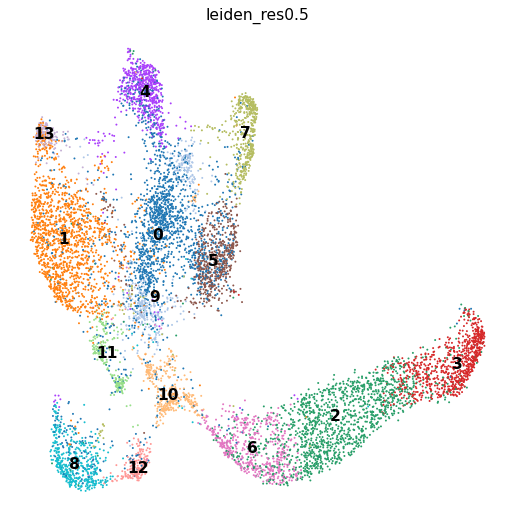

In [295]:
sc.pl.umap(adata_atac, cmap=mymap, legend_loc = 'on data',
           color = [leiden_clus_col])

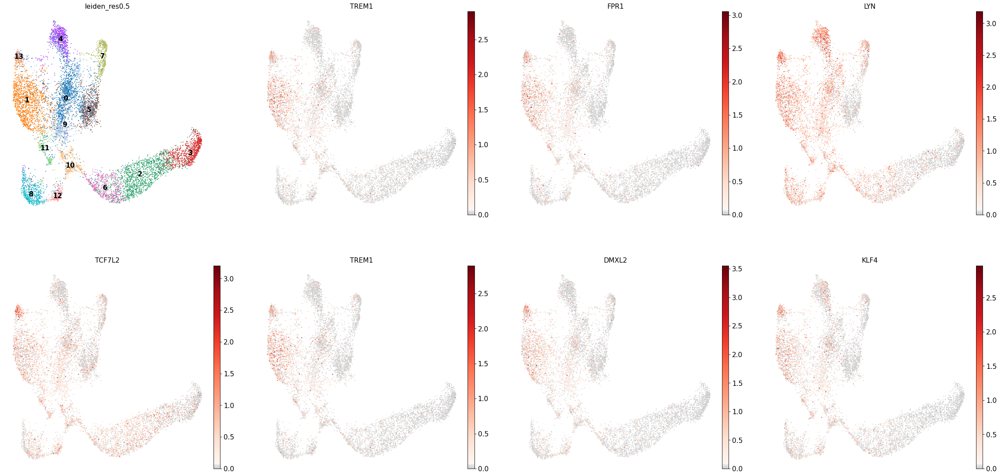

In [296]:
# Replot clusters and marker genes
sc.pl.umap(adata_atac, cmap=mymap, legend_loc = 'on data',
           color = [leiden_clus_col]+
              marker_genes['CD14+ Mono']+
              marker_genes['CD16+ Mono']+
              marker_genes['cDC2']+
            marker_genes['ID2-hi myeloid prog']
          )

### cluster 1

In [297]:
c_id = 1

In [298]:
# Initial assignment
init_clus_dict[str(c_id)]

['CD 14+ Mono', 'CD 16+ Mono', 'CD 16+ Mono prog', 'cDC2']

#### Split for DMXL negative

For this **first** split, we use the leiden_clus_col as a starting point, for subsequent splits we use the newly generated column to get a final clustering in the end. For testing the correct resolution for each cluster we further work with a temporary cluster column.

In [299]:
# Once the resolution looks good change new_key to leiden final
orig_key = leiden_clus_col
#new_key = 'leiden_temp'
new_key = 'leiden_sub' 
new_rg_key = 'rg_tsub'
sub_key = str(c_id)

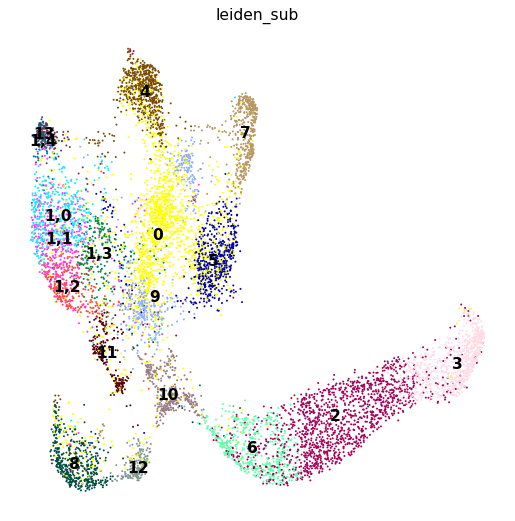

0      1850
2      1412
3       798
4       621
5       560
6       541
7       496
8       484
1,0     447
9       402
1,1     395
10      370
1,2     290
11      224
1,3     196
12      191
13      154
1,4      96
Name: leiden_sub, dtype: int64

In [300]:
res=0.4
sc.tl.leiden(adata_atac, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_atac, color=new_key, legend_loc='on data')
adata_atac.obs[new_key].value_counts()


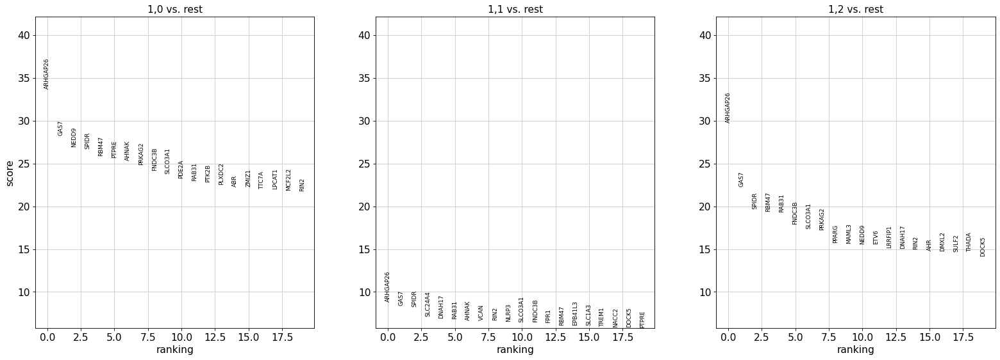

In [301]:
# Check markers of subclusters

#set number of clusters
num_subclusts = 3

new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_atac, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_atac, key=new_rg_key, groups=new_groups, ncols=3)

### Summary

- 1,0: 'CD14+ Mono'
- 1,1: 'CD14+ Mono'
- 1,2: 'CD14+ Mono'
- 1,3: '~doublet'
- 13: 'CD16+ Mono'

### cluster 11 & 12

In [302]:
c_id =11

In [303]:
# Initial assignment
init_clus_dict[str(c_id)]

['pDCs']

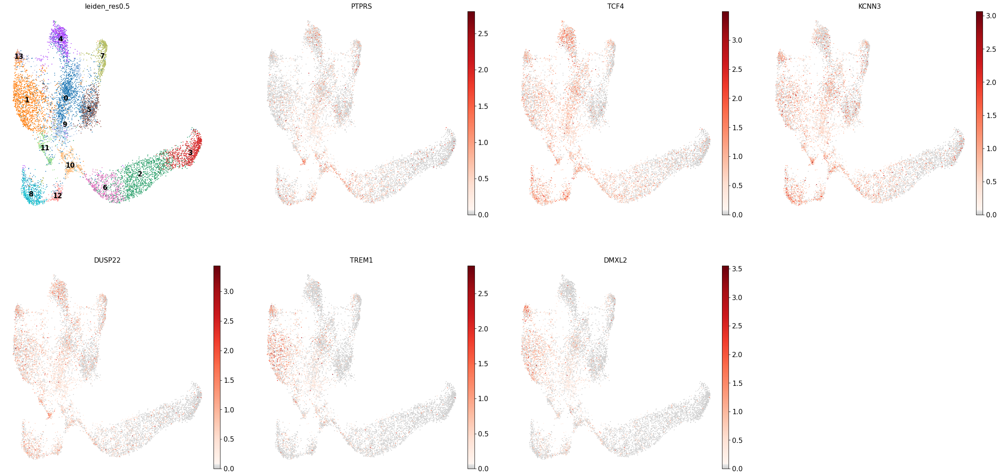

In [304]:
# Replot clusters and marker genes
sc.pl.umap(adata_atac, cmap=mymap, legend_loc = 'on data',
           color = [leiden_clus_col]+
              marker_genes['pDCs'] + 
              marker_genes['cDC2']
          )

In [305]:
# Once the resolution looks good change new_key to leiden final
orig_key = 'leiden_sub'
#new_key = 'leiden_temp'
new_key = 'leiden_sub' 
new_rg_key = 'rg_tsub'
sub_key = str(c_id)

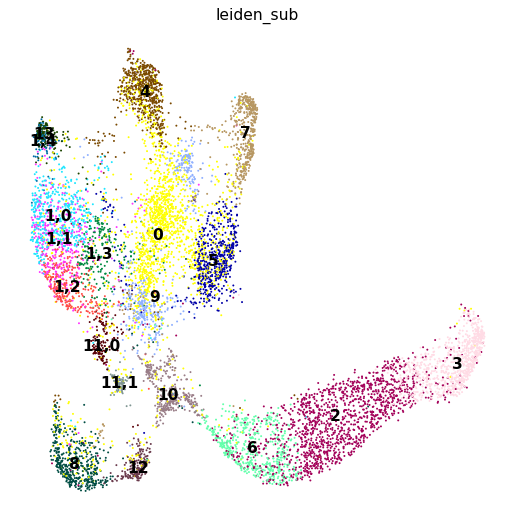

0       1850
2       1412
3        798
4        621
5        560
6        541
7        496
8        484
1,0      447
9        402
1,1      395
10       370
1,2      290
1,3      196
12       191
13       154
11,0     137
1,4       96
11,1      87
Name: leiden_sub, dtype: int64

In [306]:
res=0.2
sc.tl.leiden(adata_atac, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_atac, color=new_key, legend_loc='on data')
adata_atac.obs[new_key].value_counts()


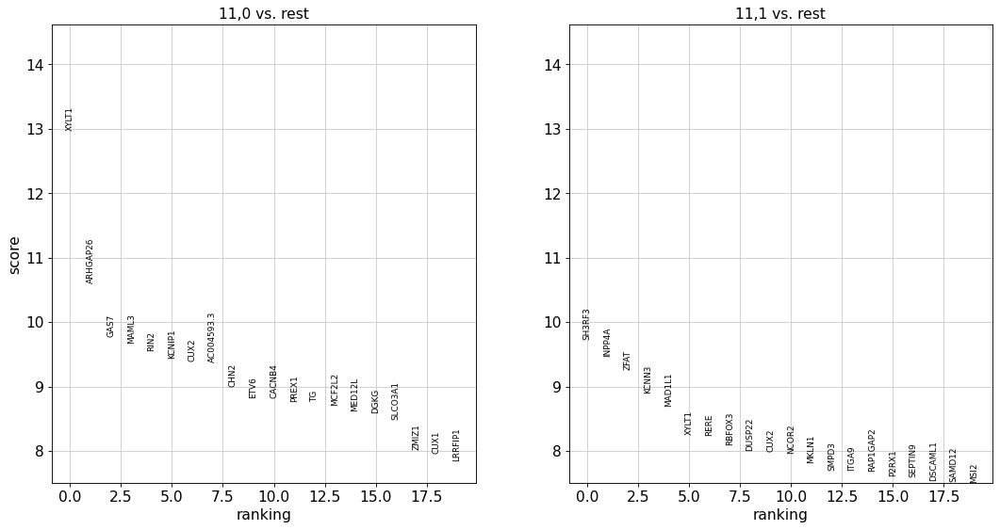

In [307]:
# Check markers of subclusters

#set number of clusters
num_subclusts = 2

new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_atac, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_atac, key=new_rg_key, groups=new_groups, ncols=3)

For this **second and subsequent** splits, we use the newly generated column.

In [308]:
# Once the resolution looks good change new_key to leiden_sub
orig_key = 'leiden_sub'
#new_key = 'leiden_temp'
new_key = 'leiden_sub'
new_rg_key = 'rg_tsub'
sub_key = str(c_id)

In [309]:
res=0.3
sc.tl.leiden(adata_atac, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_atac, color=new_key)#, legend_loc='on data')
adata_atac.obs[new_key].value_counts()


ValueError: '11' is not a valid category for 'leiden_sub'

In [310]:
# Replot clusters and marker genes
sc.pl.umap(adata_atac, cmap=mymap, legend_loc = 'on data',
           color = [new_key]+
              marker_genes['HSC']+
              marker_genes['HSPC/Mono prog']+
              marker_genes['MK/E prog']
          )

KeyError: 'HSPC/Mono prog'

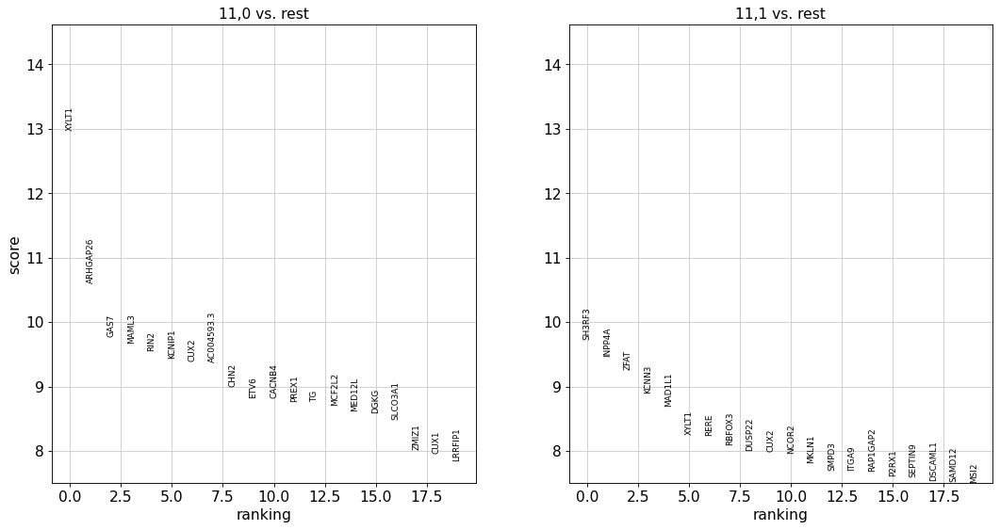

In [311]:
# Check markers of subclusters

#set number of clusters
num_subclusts = 2

new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_atac, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_atac, key=new_rg_key, groups=new_groups, ncols=3)

### Summary

most likely:
- 11,1 : pDCs
- 11,0 : ~cDC2
- 12: ~
 

### cluster 10

In [312]:
c_id = 10

In [313]:
# Initial assignment
init_clus_dict[str(c_id)]

['HSC']

In [314]:
# Once the resolution looks good change new_key to leiden_sub
orig_key = 'leiden_sub'
#new_key = 'leiden_temp'
new_key = 'leiden_sub'
new_rg_key = 'rg_tsub'
sub_key = str(c_id)

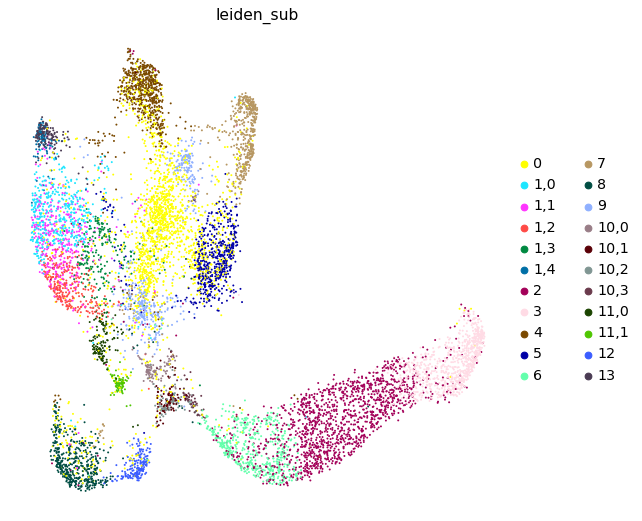

0       1850
2       1412
3        798
4        621
5        560
6        541
7        496
8        484
1,0      447
9        402
1,1      395
1,2      290
1,3      196
12       191
13       154
11,0     137
10,0     124
10,1     101
1,4       96
10,2      88
11,1      87
10,3      57
Name: leiden_sub, dtype: int64

In [315]:
res=0.3
sc.tl.leiden(adata_atac, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_atac, color=new_key)#, legend_loc='on data')
adata_atac.obs[new_key].value_counts()


Trying to set attribute `.uns` of view, copying.


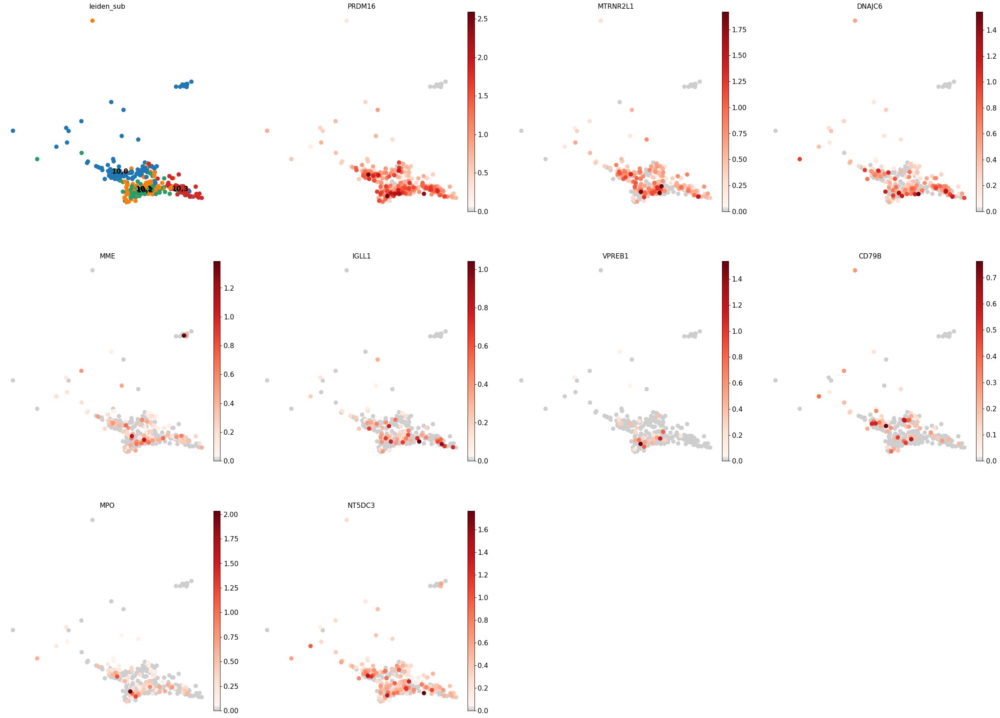

In [319]:
# Replot clusters and marker genes
sc.pl.umap(adata_atac[adata_atac.obs[new_key].isin(['10,0','10,1','10,2', '10,3'])], cmap=mymap, legend_loc = 'on data',
           color = [new_key]+
              marker_genes['HSC']+
              marker_genes['MK/E prog']+
              marker_genes['Lymph prog']+
              marker_genes['G/M prog']
          )

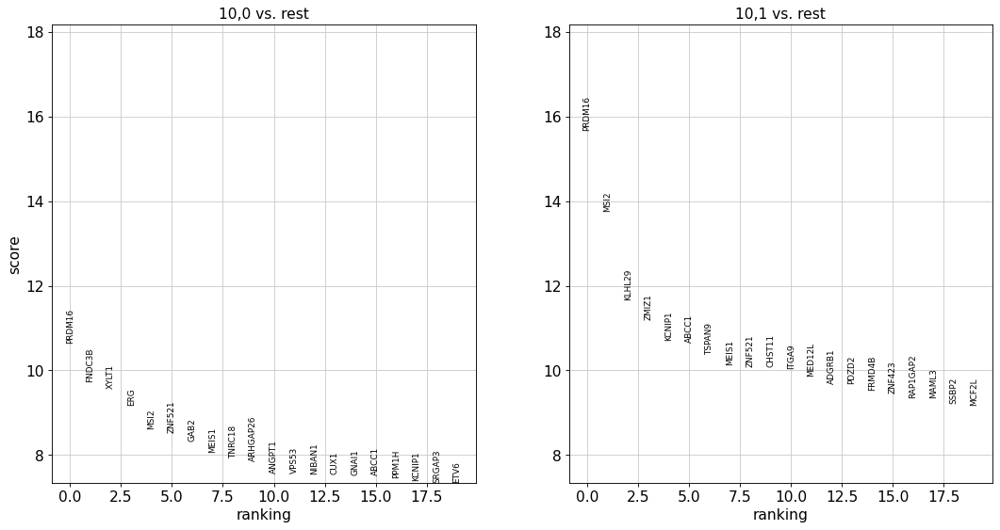

In [320]:
# Check markers of subclusters

#set number of clusters
num_subclusts = 2

new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_atac, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_atac, key=new_rg_key, groups=new_groups, ncols=3)

### Summary

most likely:
- 10,0: 'G/M prog'
- 10,1: 'Lymph prog'
- 10,2: 'HSC'
- 10,3: 'MK/E prog'

## Proerythroblast - Erythroblast - Reticulocyte

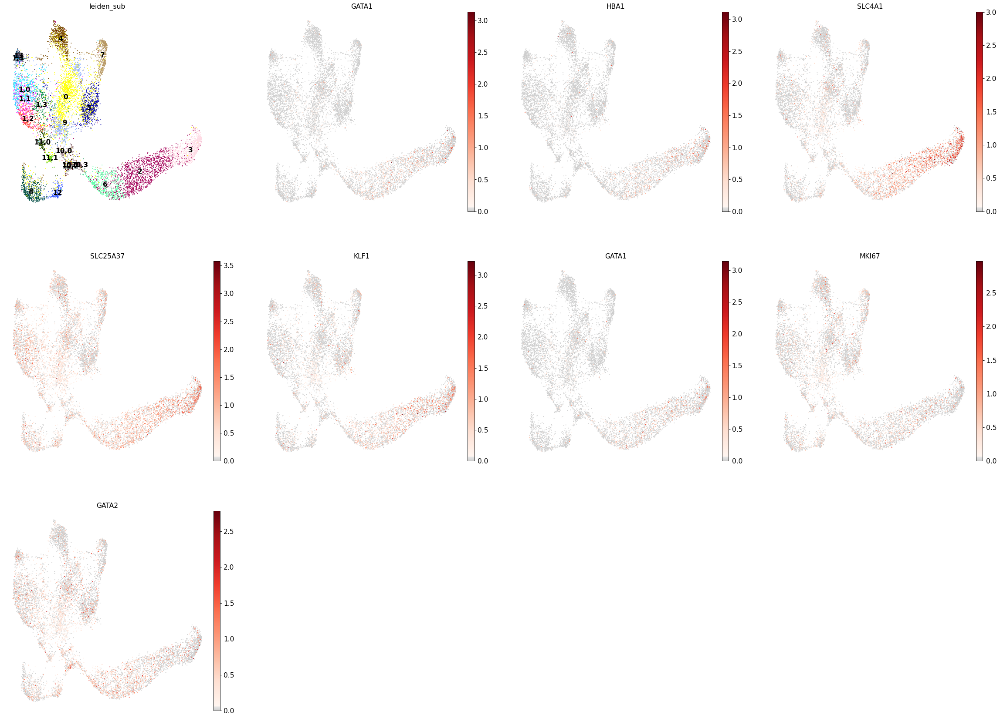

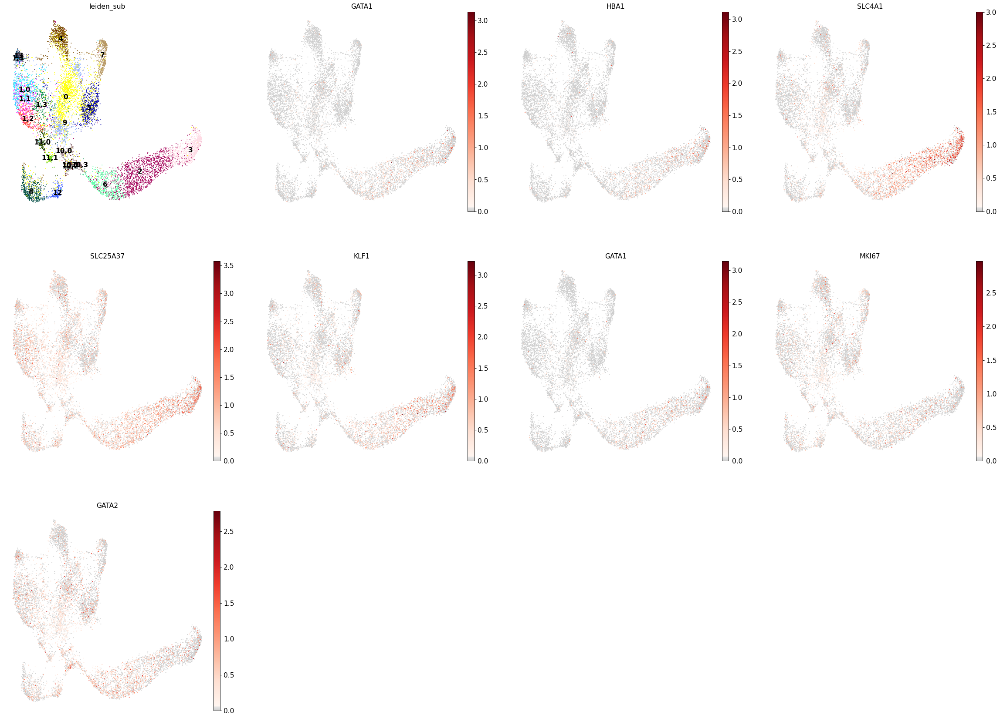

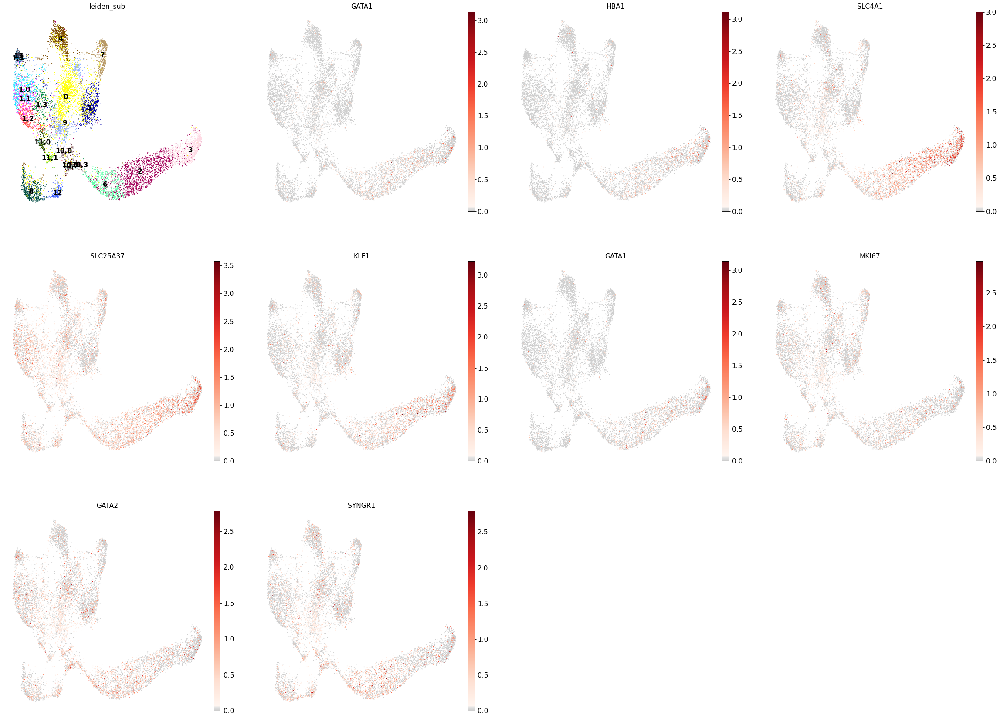

In [324]:
# Replot clusters and marker genes
sc.pl.umap(adata_atac, cmap=mymap, legend_loc = 'on data',
           color = ['leiden_sub']+
              marker_genes['Reticulocyte']+
              marker_genes['Erythroblast']+
              marker_genes['Proerythroblast']
          )

## Summary

- 6: Proerythroblast
- 2: Erythroblast
- 3: Reticulocyte

## NK - ILC

In [325]:
marker_genes

{'CD14+ Mono': ['TREM1', 'FPR1'],
 'CD16+ Mono': ['LYN', 'TCF7L2'],
 'ID2-hi myeloid prog': ['KLF4'],
 'cDC2': ['TREM1', 'DMXL2'],
 'Reticulocyte': ['GATA1', 'HBA1', 'SLC4A1', 'SLC25A37', 'KLF1'],
 'Erythroblast': ['GATA1', 'MKI67'],
 'Proerythroblast': ['GATA2', 'SYNGR1'],
 'NK': ['CD160', 'GNLY', 'GRIK4', 'CD247'],
 'ILC': ['SPON2', 'GZMB', 'PRF1', 'C69'],
 'Lymph prog': ['MME', 'IGLL1', 'VPREB1', 'CD79B'],
 'Naive CD20+ B': ['MS4A1', 'LYN', 'CD74', 'BLK'],
 'B1 B': ['ITGB1', 'MS4A1', 'DUSP22', 'EPHA4'],
 'Transitional B': ['MME', 'CD38', 'CD24'],
 'Plasma cells': ['DUSP22', 'FNDC3B'],
 'CD4+ T activated': ['JAKMIP1', 'C4orf50'],
 'CD4+ T naive': ['BCL11B', 'BACH2', 'JAKMIP1', 'C4orf50'],
 'CD8+ T': ['CD8A', 'CD8B'],
 'pDCs': ['PTPRS', 'TCF4', 'KCNN3', 'DUSP22'],
 'G/M prog': ['MPO', 'NT5DC3'],
 'HSC': ['PRDM16', 'MTRNR2L1'],
 'MK/E prog': ['DNAJC6']}

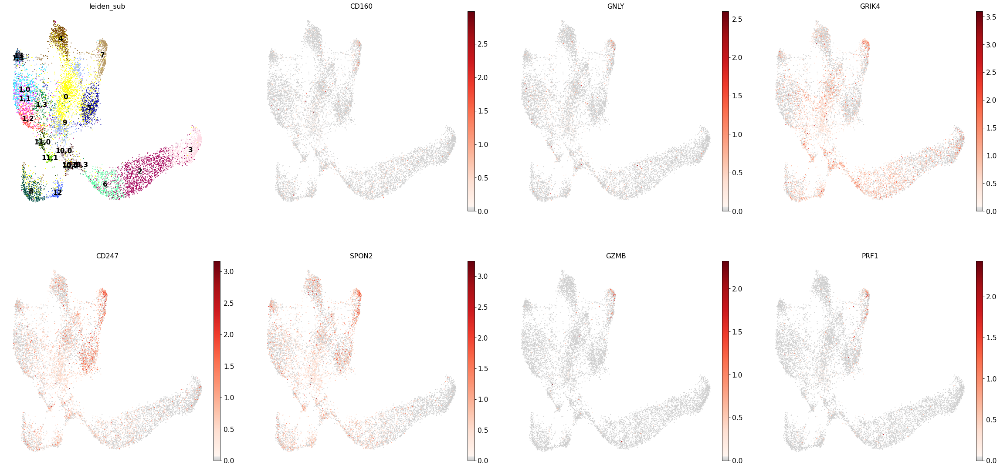

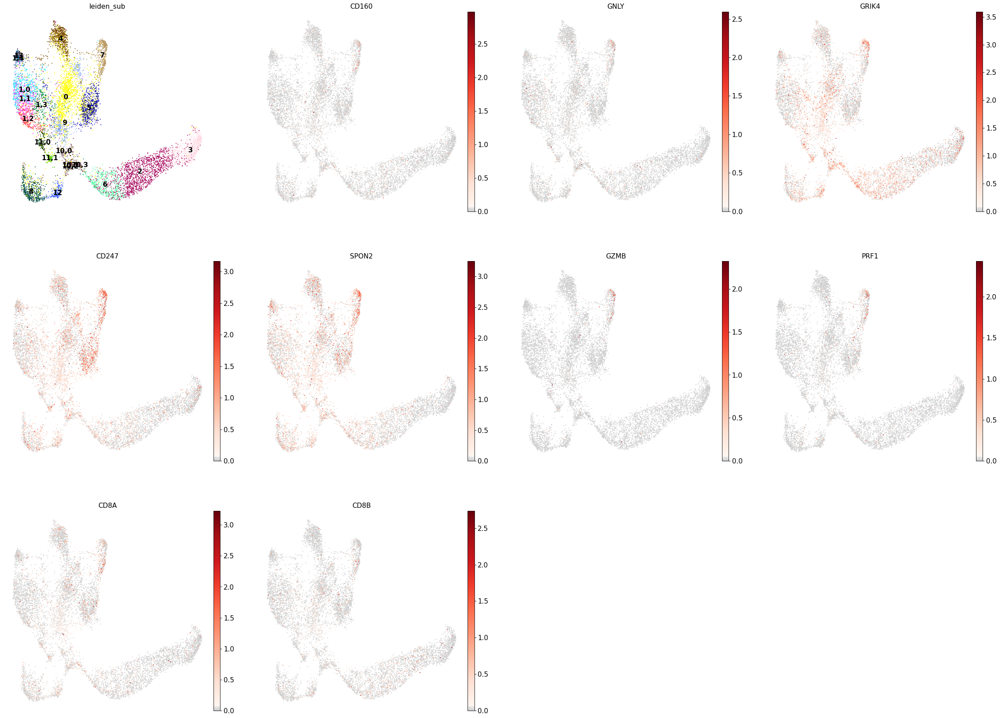

In [328]:
# Replot clusters and marker genes
sc.pl.umap(adata_atac, cmap=mymap, legend_loc = 'on data',
           color = ['leiden_sub']+
              marker_genes['NK']+
              marker_genes['ILC']+
              marker_genes['CD8+ T']
          )

### cluster 7

In [329]:
c_id = 7

In [330]:
# Initial assignment
init_clus_dict[str(c_id)]

['NK', 'ILC', 'CD8+ T']

In [331]:
# Once the resolution looks good change new_key to leiden final
orig_key = 'leiden_sub'
#new_key = 'leiden_temp'
new_key = 'leiden_sub'
new_rg_key = 'rg_tsub'
sub_key = str(c_id)

In [332]:
res=0.2
sc.tl.leiden(adata_atac, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)

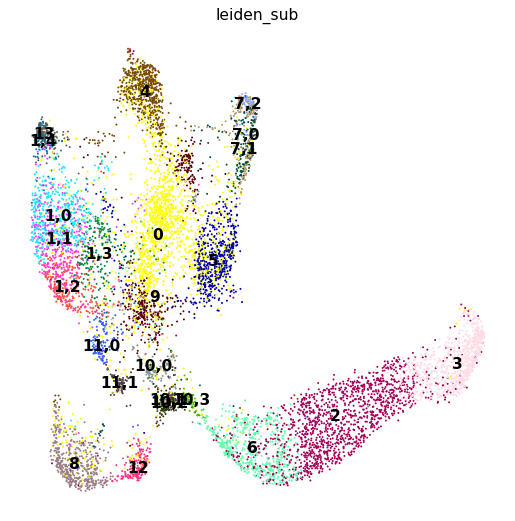

0       1850
2       1412
3        798
4        621
5        560
6        541
8        484
1,0      447
9        402
1,1      395
1,2      290
7,0      236
1,3      196
12       191
7,1      183
13       154
11,0     137
10,0     124
10,1     101
1,4       96
10,2      88
11,1      87
7,2       77
10,3      57
Name: leiden_sub, dtype: int64

In [333]:
sc.pl.umap(adata_atac, color=new_key, legend_loc='on data')
adata_atac.obs[new_key].value_counts()

Trying to set attribute `.uns` of view, copying.


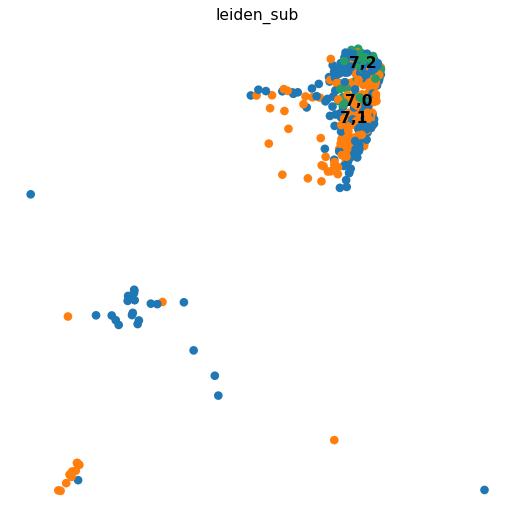

In [334]:
sc.pl.umap(adata_atac[adata_atac.obs[new_key].isin(['7,0','7,1','7,2'])], color=new_key, legend_loc='on data')

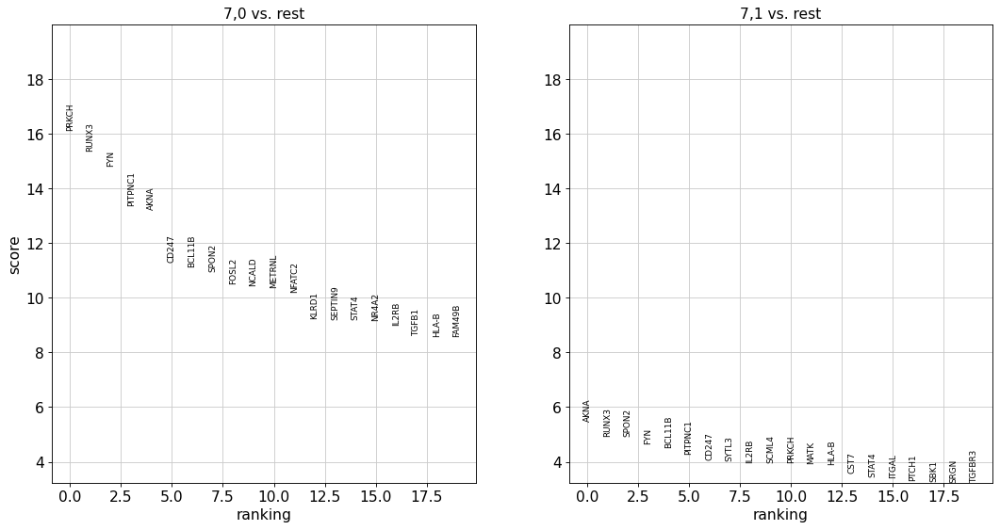

In [335]:
# Check markers of subclusters

#set number of clusters
num_subclusts = 2

new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_atac, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_atac, key=new_rg_key, groups=new_groups, ncols=3)

## Summary

- 7,0: 'CD8+ T'
- 7,1: 'ILC/CD8+ T'
- 7,2: 'NK'

## B cells

In [336]:
marker_genes

{'CD14+ Mono': ['TREM1', 'FPR1'],
 'CD16+ Mono': ['LYN', 'TCF7L2'],
 'ID2-hi myeloid prog': ['KLF4'],
 'cDC2': ['TREM1', 'DMXL2'],
 'Reticulocyte': ['GATA1', 'HBA1', 'SLC4A1', 'SLC25A37', 'KLF1'],
 'Erythroblast': ['GATA1', 'MKI67'],
 'Proerythroblast': ['GATA2', 'SYNGR1'],
 'NK': ['CD160', 'GNLY', 'GRIK4', 'CD247'],
 'ILC': ['SPON2', 'GZMB', 'PRF1'],
 'Lymph prog': ['MME', 'IGLL1', 'VPREB1', 'CD79B'],
 'Naive CD20+ B': ['MS4A1', 'LYN', 'CD74', 'BLK'],
 'B1 B': ['ITGB1', 'MS4A1', 'DUSP22', 'EPHA4'],
 'Transitional B': ['MME', 'CD38', 'CD24'],
 'Plasma cells': ['DUSP22', 'FNDC3B'],
 'CD4+ T activated': ['JAKMIP1', 'C4orf50'],
 'CD4+ T naive': ['BCL11B', 'BACH2', 'JAKMIP1', 'C4orf50'],
 'CD8+ T': ['CD8A', 'CD8B'],
 'pDCs': ['PTPRS', 'TCF4', 'KCNN3', 'DUSP22'],
 'G/M prog': ['MPO', 'NT5DC3'],
 'HSC': ['PRDM16', 'MTRNR2L1'],
 'MK/E prog': ['DNAJC6']}

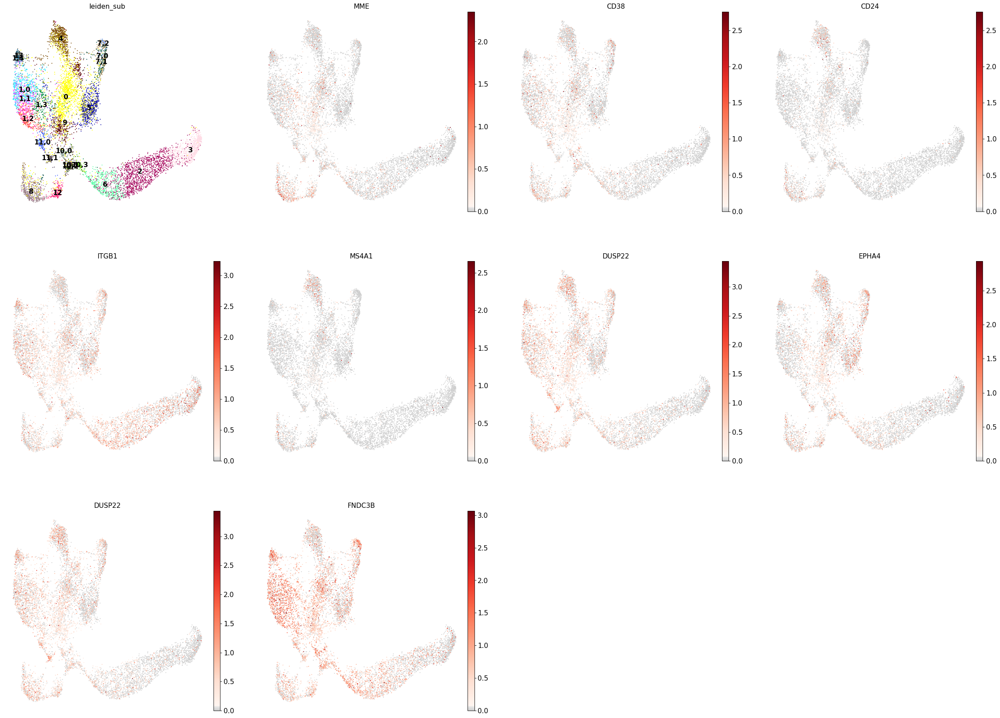

In [337]:
# Replot clusters and marker genes
sc.pl.umap(adata_atac, cmap=mymap, legend_loc = 'on data',
           color = ['leiden_sub']+
              marker_genes['Transitional B']+
              marker_genes['B1 B']+
              marker_genes['Plasma cells']
          )

### cluster 8

In [338]:
c_id = 8

In [339]:
# Once the resolution looks good change new_key to leiden_sub
orig_key = 'leiden_sub'
#new_key = 'leiden_temp'
new_key = 'leiden_sub'
new_rg_key = 'rg_tsub'
sub_key = str(c_id)

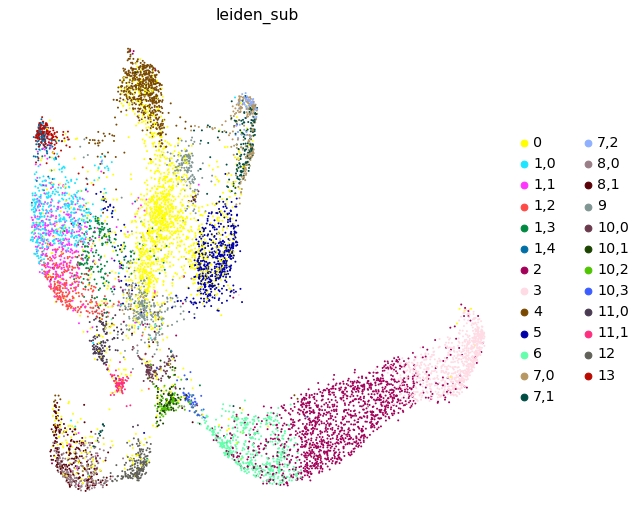

0       1850
2       1412
3        798
4        621
5        560
6        541
1,0      447
9        402
1,1      395
1,2      290
8,0      253
7,0      236
8,1      231
1,3      196
12       191
7,1      183
13       154
11,0     137
10,0     124
10,1     101
1,4       96
10,2      88
11,1      87
7,2       77
10,3      57
Name: leiden_sub, dtype: int64

In [340]:
res=0.3
sc.tl.leiden(adata_atac, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_atac, color=new_key)#, legend_loc='on data')
adata_atac.obs[new_key].value_counts()


## Summary

- 8: 'Transitional B'

## cluster 5: T cells

In [341]:
marker_genes

{'CD14+ Mono': ['TREM1', 'FPR1'],
 'CD16+ Mono': ['LYN', 'TCF7L2'],
 'ID2-hi myeloid prog': ['KLF4'],
 'cDC2': ['TREM1', 'DMXL2'],
 'Reticulocyte': ['GATA1', 'HBA1', 'SLC4A1', 'SLC25A37', 'KLF1'],
 'Erythroblast': ['GATA1', 'MKI67'],
 'Proerythroblast': ['GATA2', 'SYNGR1'],
 'NK': ['CD160', 'GNLY', 'GRIK4', 'CD247'],
 'ILC': ['SPON2', 'GZMB', 'PRF1'],
 'Lymph prog': ['MME', 'IGLL1', 'VPREB1', 'CD79B'],
 'Naive CD20+ B': ['MS4A1', 'LYN', 'CD74', 'BLK'],
 'B1 B': ['ITGB1', 'MS4A1', 'DUSP22', 'EPHA4'],
 'Transitional B': ['MME', 'CD38', 'CD24'],
 'Plasma cells': ['DUSP22', 'FNDC3B'],
 'CD4+ T activated': ['JAKMIP1', 'C4orf50'],
 'CD4+ T naive': ['BCL11B', 'BACH2', 'JAKMIP1', 'C4orf50'],
 'CD8+ T': ['CD8A', 'CD8B'],
 'pDCs': ['PTPRS', 'TCF4', 'KCNN3', 'DUSP22'],
 'G/M prog': ['MPO', 'NT5DC3'],
 'HSC': ['PRDM16', 'MTRNR2L1'],
 'MK/E prog': ['DNAJC6']}

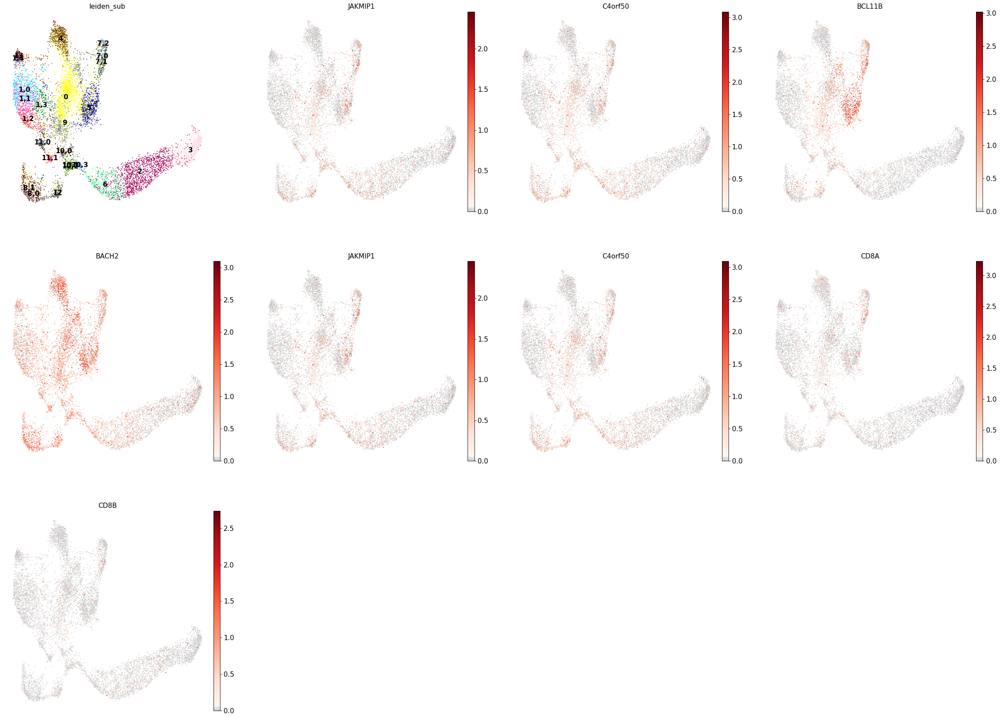

In [342]:
# Replot clusters and marker genes
sc.pl.umap(adata_atac, cmap=mymap, legend_loc = 'on data',
           color = ['leiden_sub']+
           marker_genes['CD4+ T activated']+
           marker_genes['CD4+ T naive']+
           marker_genes['CD8+ T']
          )

### cluster 5

In [343]:
c_id = 5

In [344]:
# Initial assignment
init_clus_dict[str(c_id)]

['CD4+ T naive', 'CD4+ T activated']

In [345]:
# Once the resolution looks good change new_key to leiden_sub
orig_key = 'leiden_sub'
#new_key = 'leiden_temp'
new_key = 'leiden_sub'
new_rg_key = 'rg_tsub'
sub_key = str(c_id)

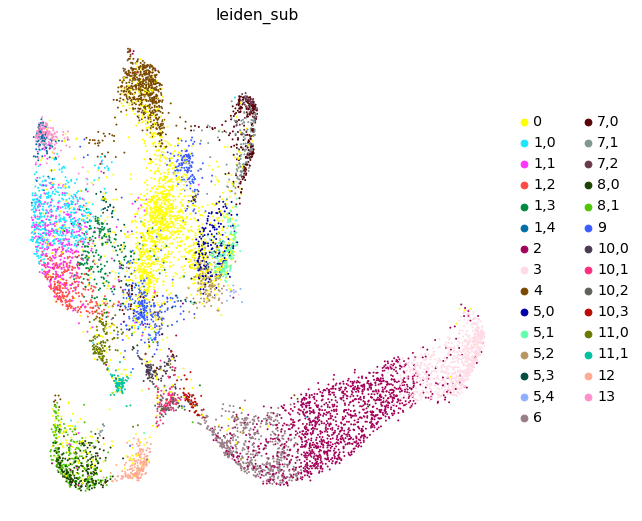

0       1850
2       1412
3        798
4        621
6        541
1,0      447
9        402
1,1      395
1,2      290
8,0      253
7,0      236
8,1      231
1,3      196
12       191
5,0      187
7,1      183
5,1      165
13       154
5,2      144
11,0     137
10,0     124
10,1     101
1,4       96
10,2      88
11,1      87
7,2       77
10,3      57
5,3       52
5,4       12
Name: leiden_sub, dtype: int64

In [346]:
res=0.4
sc.tl.leiden(adata_atac, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_atac, color=new_key)#, legend_loc='on data')
adata_atac.obs[new_key].value_counts()


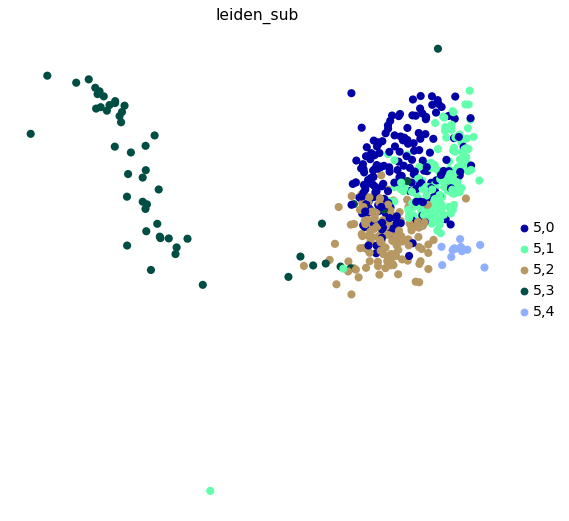

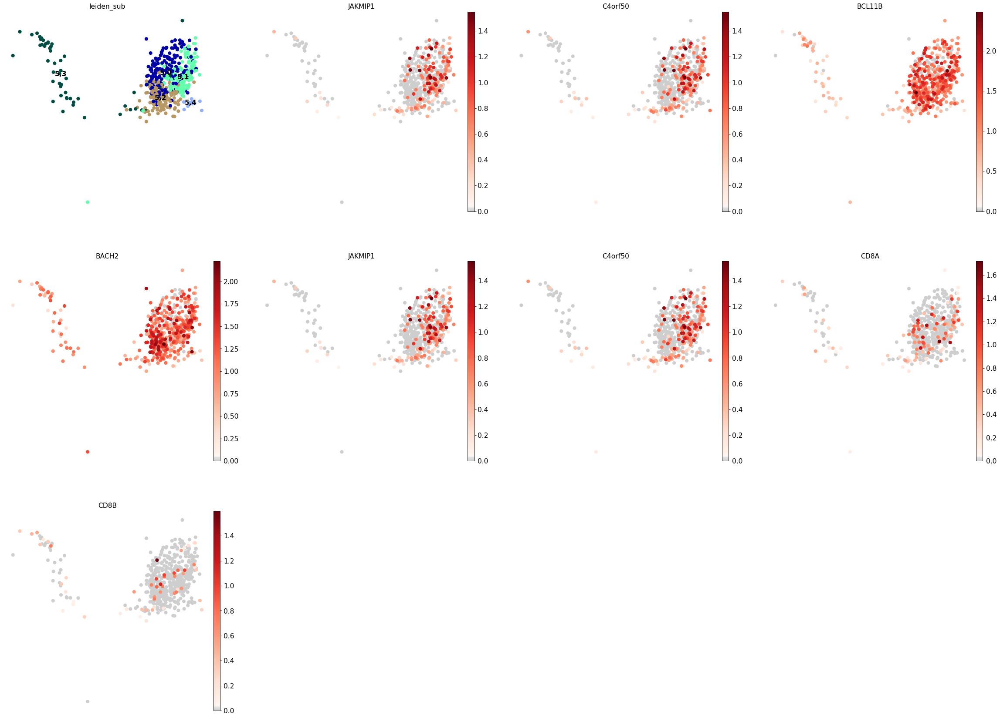

In [347]:
sc.pl.umap(adata_atac[adata_atac.obs[new_key].isin(['5,0','5,1','5,2','5,3','5,4'])], color=new_key)#, legend_loc='on data')
sc.pl.umap(adata_atac[adata_atac.obs[new_key].isin(['5,0','5,1','5,2','5,3','5,4'])], cmap=mymap, legend_loc = 'on data',
           color = ['leiden_sub']+
           marker_genes['CD4+ T activated']+
           marker_genes['CD4+ T naive']+
           marker_genes['CD8+ T']
          )

### Summary

most likely:
- 5,0: 'CD4+ T activated'
- 5,1: 'CD4+ T activated'
- 5,2: 'CD8+ T'
- 5,3: 'CD4+ T Naive'
- 5,4: '~'

### cluster 4

In [348]:
c_id = 4

In [349]:
# Initial assignment
init_clus_dict[str(c_id)]

['Naive CD20+ B']

### Summary

- 4 : 'Naive CD20+ B'

## Final annotation

In [383]:
final_clus_dict = {
    
    '0':'doublet',
    
    '1,0': 'CD14+ Mono',
    '1,1': 'CD14+ Mono',
    '1,2': 'CD14+ Mono',
    '1,3': 'doublet',
    
    '2': 'Erythroblast',
    
    '3': 'Normoblast',
    
    '4': 'Naive CD20+ B',
    
    '5,0': 'CD4+ T naive',
    '5,1': 'CD4+ T activated',
    '5,2': 'CD4+ T naive',
    '5,3': '~',
    '5,4': '~CD4+ T naive',
    
    '6': 'Proerythroblast',
    
    '7,0': 'CD8+ T',
    '7,1': 'CD8+ T/ILC',
    '7,2': 'NK',
    
    '8,0': 'Transitional B',
    '8,1': 'Transitional B',
    
    '9': 'doublet',
    
    '10,0': 'G/M prog',
    '10,1': 'Lymph prog',
    '10,2': 'HSC',
    '10,3': 'MK/E prog',
    

    '11,1': 'pDCs',
    '11,0': 'cDC2',
    
    '12': '~pDCs',
    
    '13': 'CD16+ Mono'
    
}

## Marker overview

In [384]:
# Rename clusters
adata_atac.obs['leiden_final'] = adata_atac.obs.leiden_sub.map(final_clus_dict)

... storing 'leiden_final' as categorical


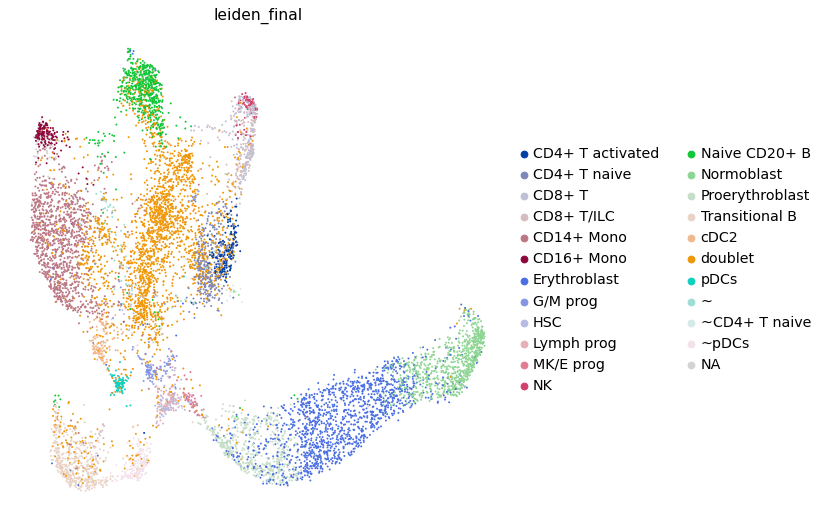

In [385]:
sc.pl.umap(adata_atac, color='leiden_final')

In [386]:
#Overview
adata_plot = adata_atac.copy()
sc.pp.scale(adata_plot, max_value=4)

Note on marker overview: Compared to the RNA seq markers, the gene activity scores are less distict between clusters. Often markers of multiple subtypes need to be assesed together (E.g.: B1 B and naive CD20+ B cells express very similar set of markers (they are bith B cells), but B1 B cells have higher EPHA4 gene activity, therefore distiction can be made)

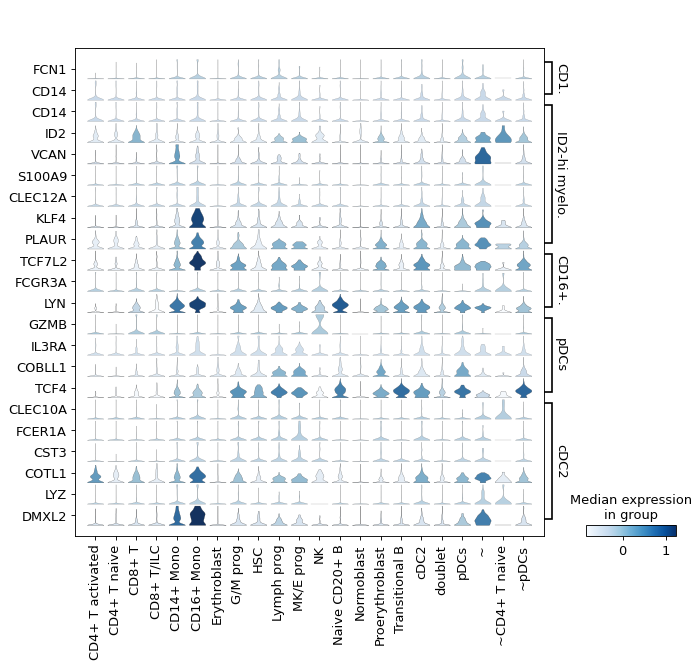

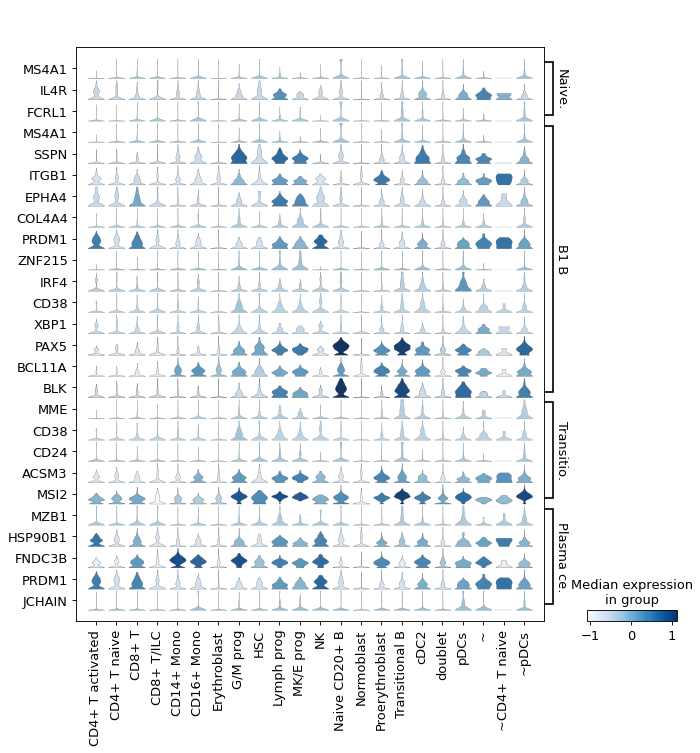

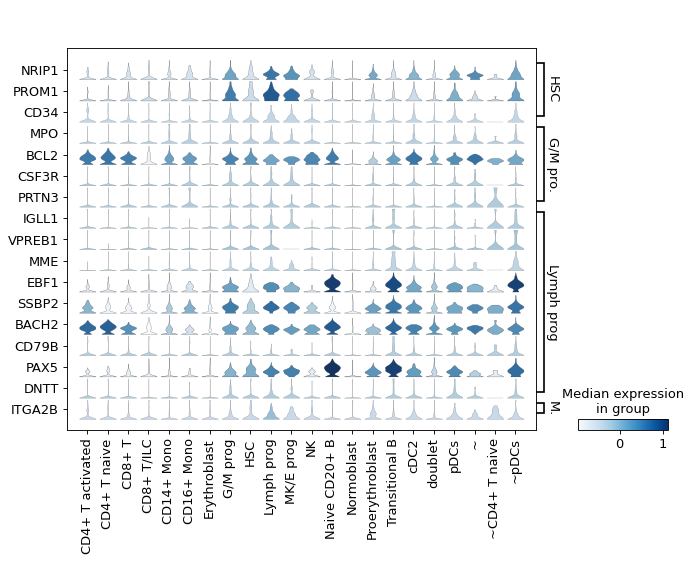

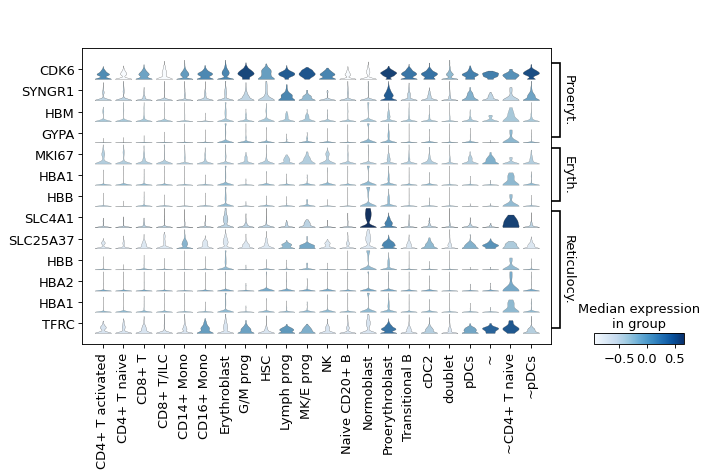

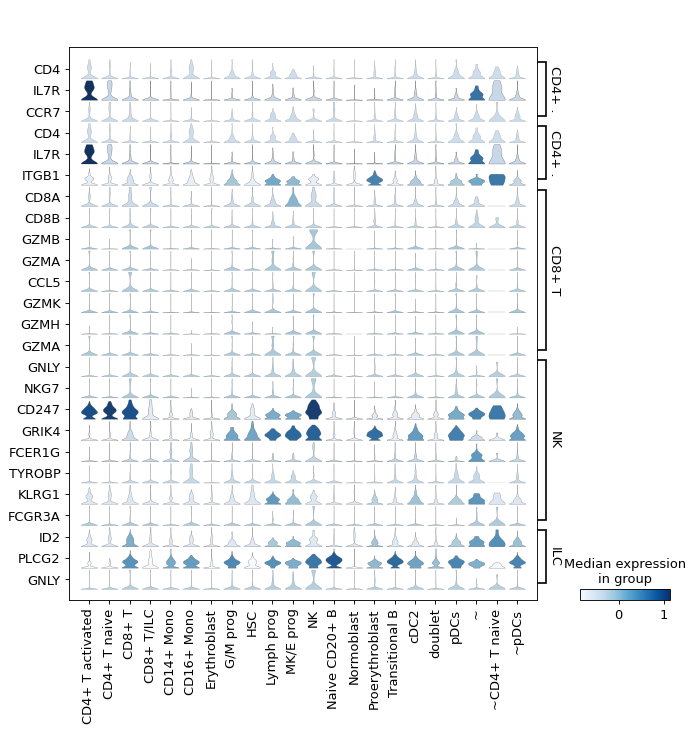

In [387]:
#Monocytes
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_genes_updated[a] for a in ['CD14+ Mono', 'ID2-hi myeloid prog', 'CD16+ Mono', 'pDCs', 'cDC2']})

#B cells
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_genes_updated[a] for a in ['Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells']})

#Progenitors
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_genes_updated[a] for a in ['HSC', 'G/M prog', 'Lymph prog', 'MK/E prog']})

#Erythropoiesis
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_genes_updated[a] for a in ['Proerythroblast', 'Erythroblast', 'Reticulocyte']})


#T & NK cells
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_genes_updated[a] for a in ['CD4+ T naive', 'CD4+ T activated', 'CD8+ T', 'NK', 'ILC']})

## Write output

In [388]:
adata_atac

AnnData object with n_obs × n_vars = 9527 × 19039
    obs: 'nCount_peaks', 'atac_fragments', 'TSS.enrichment', 'reads_in_peaks_frac', 'blacklist_fraction', 'nucleosome_signal', 'leiden_res0.3', 'leiden_res0.5', 'leiden_res0.8', 'leiden_res1', 'leiden_sub', 'leiden_final', 'leiden_temp'
    uns: 'neighbors', 'leiden', 'leiden_res0.3_colors', 'leiden_res0.5_colors', 'leiden_res0.8_colors', 'leiden_res1_colors', 'rank_genes_res0.5', 'leiden_sub_colors', 'rg_tsub', 'leiden_final_colors', 'leiden_temp_colors'
    obsm: 'lsi_full', 'lsi_red', 'peaks', 'umap'
    obsp: 'distances', 'connectivities'

In [389]:
adata_atac_slim = adata_atac.copy()

In [390]:
adata_atac_slim.obs = adata_atac.obs[['nCount_peaks','atac_fragments',
                                     'reads_in_peaks_frac','blacklist_fraction','nucleosome_signal',
                                     'leiden_final']]
del adata_atac_slim.uns
adata_atac_slim.uns['neighbors'] = adata_atac.uns['neighbors']

In [391]:
adata_atac_slim

AnnData object with n_obs × n_vars = 9527 × 19039
    obs: 'nCount_peaks', 'atac_fragments', 'reads_in_peaks_frac', 'blacklist_fraction', 'nucleosome_signal', 'leiden_final'
    uns: 'neighbors'
    obsm: 'lsi_full', 'lsi_red', 'peaks', 'umap'
    obsp: 'distances', 'connectivities'

In [392]:
adata_atac_slim.write_h5ad('sample2_donor4_atac.h5ad')

In [393]:
adata_atac_slim.obs_names

Index(['AAACAGCCAATAGTCT-1', 'AAACAGCCACTCGCTC-1', 'AAACAGCCAGCTACGT-1',
       'AAACAGCCATTGCAGC-1', 'AAACATGCACACTAAT-1', 'AAACATGCACCTCAGG-1',
       'AAACATGCACGTTACA-1', 'AAACATGCACTTACAG-1', 'AAACATGCAGGGAGCT-1',
       'AAACATGCATTGCAGC-1',
       ...
       'TTTGTGTTCACAAGCT-1', 'TTTGTGTTCATAATCG-1', 'TTTGTGTTCATTAGTG-1',
       'TTTGTGTTCCTAACGG-1', 'TTTGTGTTCGGGCCAT-1', 'TTTGTGTTCGGTTTGG-1',
       'TTTGTTGGTCATTACC-1', 'TTTGTTGGTGACCTGG-1', 'TTTGTTGGTGTAATAC-1',
       'TTTGTTGGTTTGGTTC-1'],
      dtype='object', length=9527)